Детектор аномалий на GAN c MNIST в качестве датасета аномалий

In [49]:
from dataclasses import dataclass
from datetime import datetime

import sklearn.metrics as metrics
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import numpy as np 
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
from torchvision import datasets, transforms
from tqdm.auto import tqdm
from torchfuzzy import FuzzyLayer, DefuzzyLinearLayer, FuzzyBellLayer
import os
from sklearn.manifold import TSNE

import piqa

os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
os.environ['TORCH_USE_CUDA_DSA'] = "1"

In [50]:
batch_size = 256

ngf = 2
ndf = 2
fuzzy_cores = 30
latent_dim = 7
niter = 300

mnist_dissident = 0

prefix = f"fuzzy_gan_anomaly_detection"
writer = SummaryWriter(f'runs/mnist/{prefix}_{datetime.now().strftime("%Y%m%d-%H%M%S")}')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

### Load MNIST

In [51]:
def norm_and_transform(x):
    nimg = 2.0*(x.view(-1, 28, 28) - 0.5)
    nimg = torch.clamp(nimg, -1, 1)
    return nimg

transform = transforms.Compose([
    transforms.ToTensor(), 
    transforms.RandomCrop(size=26),
    transforms.Resize(size=(28, 28)),
    transforms.Lambda(norm_and_transform)
])

In [52]:
# загружаем обучающую выборку

def get_target_and_mask(target_label):
    t = target_label
    return t 

train_data = datasets.MNIST(
    '~/.pytorch/MNIST_data/', 
    download=True, 
    train=True, 
    transform = transform,
    target_transform = transforms.Lambda(get_target_and_mask)
)

idx = (train_data.targets != mnist_dissident)
train_data.targets = train_data.targets[idx]
train_data.data = train_data.data[idx]
len(train_data)

54077

In [53]:
# загружаем тестовую выборку
test_data = datasets.MNIST(
    '~/.pytorch/MNIST_data/', 
    download=True, 
    train=False, 
    transform=transform, 
    target_transform = transforms.Lambda(lambda x: get_target_and_mask(x))
)
len(test_data)

10000

In [54]:
# Создаем итераторы датасетов
train_loader = torch.utils.data.DataLoader(
    train_data, 
    batch_size=batch_size, 
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_data, 
    batch_size=batch_size, 
    shuffle=False,
)


tensor(0.9953)
tensor(-1.)
tensor(8)


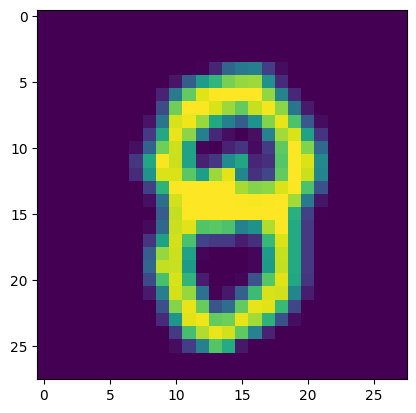

In [55]:
for data, label in iter(train_loader):
    plt.imshow(data[0].squeeze())
    print(data[0].max())
    print(data[0].min())
    print(label[0])
    break

## DCGAN Model

In [56]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [57]:
class Generator(nn.Module):
    def __init__(self, ngf, fuzzy_cores):
        super(Generator, self).__init__()
        
        self.main = nn.Sequential(
            
            nn.Linear(fuzzy_cores, 16*ngf),
            nn.SiLU(), 

            nn.BatchNorm1d(16*ngf, momentum=0.01, track_running_stats = False),
            nn.Unflatten(1, (16*ngf, 1, 1)),
            nn.ConvTranspose2d(16*ngf, 8*ngf, 12),
            nn.SiLU(), 

            nn.BatchNorm2d(8*ngf, momentum=0.01, track_running_stats = False),
            nn.ConvTranspose2d(8*ngf, 4*ngf, 5),
            nn.SiLU(), 

            nn.BatchNorm2d(4*ngf, momentum=0.01, track_running_stats = False),
            nn.ConvTranspose2d(4*ngf, 2*ngf, 5),
            nn.SiLU(), 

            nn.BatchNorm2d(2*ngf, momentum=0.01, track_running_stats = False),
            nn.ConvTranspose2d(2*ngf, ngf, 5),
            nn.SiLU(), 
            
            nn.BatchNorm2d(ngf, momentum=0.01, track_running_stats = False),
            nn.ConvTranspose2d(ngf, 1, 5),
            nn.Tanh()
        )

    def forward(self, input):
        #fz = self.fuzzy(input)
        #fz = fz.div(fz.sum(-1).unsqueeze(-1))
        output = self.main(input.reshape((-1, fuzzy_cores)))
        return output

netG = Generator(ngf, fuzzy_cores).to(device)
netG.apply(weights_init)
num_params = sum(p.numel() for p in netG.parameters() if p.requires_grad)
print(f'Number of parameters: {num_params:,}')

print(netG)

Number of parameters: 79,125
Generator(
  (main): Sequential(
    (0): Linear(in_features=30, out_features=32, bias=True)
    (1): SiLU()
    (2): BatchNorm1d(32, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (3): Unflatten(dim=1, unflattened_size=(32, 1, 1))
    (4): ConvTranspose2d(32, 16, kernel_size=(12, 12), stride=(1, 1))
    (5): SiLU()
    (6): BatchNorm2d(16, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (7): ConvTranspose2d(16, 8, kernel_size=(5, 5), stride=(1, 1))
    (8): SiLU()
    (9): BatchNorm2d(8, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (10): ConvTranspose2d(8, 4, kernel_size=(5, 5), stride=(1, 1))
    (11): SiLU()
    (12): BatchNorm2d(4, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (13): ConvTranspose2d(4, 2, kernel_size=(5, 5), stride=(1, 1))
    (14): SiLU()
    (15): BatchNorm2d(2, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (16): ConvTr

In [58]:
inp = torch.rand(2, fuzzy_cores).to(device)
gg = Generator(ngf, fuzzy_cores).to(device)
gg(inp)

tensor([[[[ 0.0399,  0.0859,  0.0726,  ..., -0.0280, -0.0032, -0.0538],
          [ 0.0503,  0.0980,  0.1096,  ..., -0.1305, -0.1124, -0.1212],
          [ 0.0323,  0.1272,  0.0907,  ..., -0.2091, -0.0809, -0.1383],
          ...,
          [-0.0006,  0.0958,  0.1290,  ...,  0.1310,  0.1201,  0.1111],
          [-0.0020,  0.0220,  0.1004,  ...,  0.1416,  0.0718,  0.0782],
          [ 0.0534,  0.0580,  0.0613,  ...,  0.0559,  0.0417,  0.0309]]],


        [[[ 0.0428,  0.0907,  0.0618,  ..., -0.0418, -0.0207, -0.0643],
          [ 0.0494,  0.1286,  0.1347,  ..., -0.1300, -0.1137, -0.1319],
          [ 0.0486,  0.0989,  0.0580,  ..., -0.0887, -0.0227, -0.0802],
          ...,
          [ 0.0058,  0.0826,  0.1007,  ...,  0.1989,  0.1189,  0.1090],
          [-0.0076,  0.0286,  0.1137,  ...,  0.2199,  0.0834,  0.0970],
          [ 0.0523,  0.0540,  0.0651,  ...,  0.0668,  0.0399,  0.0321]]]],
       device='cuda:0', grad_fn=<TanhBackward0>)

In [59]:
class Discriminator(nn.Module):
    def __init__(self, ndf, fuzzy_cores, latent_dim):
        
        super(Discriminator, self).__init__()
        
        self.main = nn.Sequential(
            nn.Conv2d(1, ndf, kernel_size=5),
            nn.BatchNorm2d(ndf, momentum=0.01, track_running_stats = False),
            nn.SiLU(),  
            nn.Conv2d(ndf, 2*ndf, kernel_size=5),
            nn.BatchNorm2d(2*ndf, momentum=0.01, track_running_stats = False),
            nn.SiLU(),  
            nn.Conv2d(2*ndf, 4*ndf, kernel_size=5),
            nn.BatchNorm2d(4*ndf, momentum=0.01, track_running_stats = False),
            nn.SiLU(),  
            nn.Conv2d(4*ndf, 8*ndf, kernel_size=5),
            nn.BatchNorm2d(8*ndf, momentum=0.01, track_running_stats = False),
            nn.SiLU(),
            nn.Conv2d(8*ndf, 16*ndf, kernel_size=12),
            nn.BatchNorm2d(16*ndf, momentum=0.01, track_running_stats = False),
            nn.Flatten(),
            nn.Linear(16*ndf, latent_dim), 
        )
        
        exp_k = 2            
        
        initial_centroids = exp_k * (0.5 - np.random.rand(fuzzy_cores, latent_dim)) * 2
        initial_scales =  exp_k * np.ones((fuzzy_cores, latent_dim))
        self.fuzzy_gen = FuzzyLayer.from_centers_and_scales(initial_centroids, initial_scales, trainable=True)
        
        initial_centroids = exp_k * (0.5 - np.random.rand(fuzzy_cores, latent_dim)) * 2
        initial_scales =  exp_k * np.ones((fuzzy_cores, latent_dim))
        self.fuzzy_white = nn.Sequential(
            FuzzyLayer.from_centers_and_scales(initial_centroids, initial_scales, trainable=True),
            DefuzzyLinearLayer.from_array(np.repeat( 1.0, fuzzy_cores).reshape(1, -1), with_norm=False, trainable=False)
        )

        initial_centroids = exp_k * (0.5 - np.random.rand(fuzzy_cores, latent_dim)) * 2
        initial_scales =  exp_k * np.ones((fuzzy_cores, latent_dim))
        self.fuzzy_black = nn.Sequential(
            FuzzyLayer.from_centers_and_scales(initial_centroids, initial_scales, trainable=True),
            DefuzzyLinearLayer.from_array(np.repeat(-1.0, fuzzy_cores).reshape(1, -1), with_norm=False, trainable=False)
        )

        
    def forward(self, input):
        output = self.main(input)
        r_w = self.fuzzy_white(output)
        r_b = self.fuzzy_black(output)
        fzg = self.fuzzy_gen(output)
        
        return r_w.squeeze(), r_b.squeeze(), fzg, output
    

netD = Discriminator(ndf, fuzzy_cores, latent_dim).to(device)
netD.apply(weights_init)
num_params = sum(p.numel() for p in netD.parameters() if p.requires_grad)
print(f'Number of parameters: {num_params:,}')
print(netD)

Number of parameters: 81,545
Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 2, kernel_size=(5, 5), stride=(1, 1))
    (1): BatchNorm2d(2, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (2): SiLU()
    (3): Conv2d(2, 4, kernel_size=(5, 5), stride=(1, 1))
    (4): BatchNorm2d(4, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (5): SiLU()
    (6): Conv2d(4, 8, kernel_size=(5, 5), stride=(1, 1))
    (7): BatchNorm2d(8, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (8): SiLU()
    (9): Conv2d(8, 16, kernel_size=(5, 5), stride=(1, 1))
    (10): BatchNorm2d(16, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (11): SiLU()
    (12): Conv2d(16, 32, kernel_size=(12, 12), stride=(1, 1))
    (13): BatchNorm2d(32, eps=1e-05, momentum=0.01, affine=True, track_running_stats=False)
    (14): Flatten(start_dim=1, end_dim=-1)
    (15): Linear(in_features=32, out_features=7, bias=True)
  )
  (fuzzy_gen): Fu

In [60]:
inp = torch.rand(2, 1, 28, 28).to(device)
dd = Discriminator(ndf, fuzzy_cores, latent_dim).to(device)
dd(inp)

(tensor([0.9188, 1.0917], device='cuda:0', grad_fn=<SqueezeBackward0>),
 tensor([-0.6235, -1.1836], device='cuda:0', grad_fn=<SqueezeBackward0>),
 tensor([[0.0495, 0.0241, 0.0113, 0.0209, 0.0169, 0.0216, 0.1766, 0.0092, 0.0122,
          0.0351, 0.0194, 0.0095, 0.0091, 0.0334, 0.0065, 0.0052, 0.0229, 0.0339,
          0.0160, 0.0355, 0.0565, 0.0299, 0.0534, 0.0064, 0.0046, 0.0161, 0.0117,
          0.0070, 0.0332, 0.0243],
         [0.0058, 0.0345, 0.0180, 0.0143, 0.0761, 0.0329, 0.0126, 0.0109, 0.0233,
          0.0436, 0.0170, 0.0218, 0.0116, 0.0204, 0.0310, 0.0279, 0.0216, 0.0380,
          0.0567, 0.0170, 0.0199, 0.0266, 0.0109, 0.0430, 0.0235, 0.0140, 0.0340,
          0.0330, 0.0248, 0.0069]], device='cuda:0',
        grad_fn=<TransposeBackward0>),
 tensor([[-0.1976, -0.1612,  0.8794,  0.3082,  0.5429, -0.4133, -0.4105],
         [ 0.4119,  0.4627, -0.5360, -0.5668, -0.2706,  0.3743,  0.1488]],
        device='cuda:0', grad_fn=<AddmmBackward0>))

## Train

In [61]:
optimizerD = torch.optim.Adam(netD.parameters(), lr=8e-4, betas=(0.5, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=8e-4, betas=(0.5, 0.999))

schedulerD = torch.optim.lr_scheduler.StepLR(optimizerD, step_size=50, gamma=0.5)
schedulerG = torch.optim.lr_scheduler.StepLR(optimizerG, step_size=50, gamma=0.5)

fixed_noise_for_report = torch.rand(49, latent_dim, device=device)

In [62]:
def keep_eigenvals_positive_loss(layer, eps = 1e-15):
    ev = layer.get_transformation_matrix_eigenvals().real.min()
    ev = torch.clamp(ev, max=eps)
    return -ev

In [63]:
ssim = piqa.SSIM(window_size=11, n_channels=1, reduction='none').to(device)

def get_test_arate_distr(D, G):
    with torch.no_grad():
        firing_levels = []
        lab_true = []
        lab_pred = []

        for data, lab in tqdm(test_loader, desc='Test MNIST', disable=True):
            data = data.view((-1, 1, 28, 28)).to(device)
            
            _, _, fz_d, _ = D(data)
            generated_image = G.main(fz_d.reshape((-1, fuzzy_cores)))
            
            diff = ssim((data + 1) / 2, (generated_image + 1) / 2)#1 - torch.cosine_similarity(data.flatten(start_dim=1), generated_image.flatten(start_dim=1))
            rates = (1 - diff).abs().detach().cpu().numpy()
            
            for f, l in  zip(rates, lab):
                firing_levels.append(f)
                lab_pred.append(f)        
                if l == mnist_dissident:
                    lab_true.append(1)
                else:
                    lab_true.append(0)
                        
        fpr, tpr, threshold = metrics.roc_curve(lab_true, lab_pred)
        roc_auc = metrics.auc(fpr, tpr)
        firing_levels = np.array(firing_levels)
        return firing_levels, roc_auc, threshold

def draw_embeddings(netD, netG, epoch):
    with torch.no_grad():
        centroids_real = netD.fuzzy_gen.get_centroids().detach().cpu().numpy()

        embedings_test = []
        labels_expected = []
            
        for data, target in tqdm(test_loader, desc='Encoding', disable=True):
            data = data.view((-1,1,28,28)).to(device)
            embeding = netD.main(data)
            embedings_test.append(embeding.cpu().numpy())
            labels_expected.append(target)
        
        embedings_test = np.concatenate(embedings_test, axis=0)
        labels_expected = np.concatenate(labels_expected, axis=0)
        
        embedings_fake = []

        inp_g = netD.fuzzy_gen(fixed_noise_for_report).detach()
        fake_images = netG(inp_g)
        embeding = netD.main(fake_images)
        embedings_fake.append(embeding.cpu().numpy())

        embedings_fake = np.concatenate(embedings_fake, axis=0)    

        fig = plt.figure(layout='constrained', figsize=(13, 4))
        subfigs = fig.subfigures(1, 3, wspace=0.07)
        axsLeft = subfigs[0].subplots(1, 1, sharey=True)

        axsLeft.scatter(embedings_test[:, 0], embedings_test[:, 1], cmap='tab10', c=labels_expected, s=1)
        axsLeft.scatter(embedings_fake[:, 0], embedings_fake[:, 1], c='purple', marker='*', s=15)
        axsLeft.scatter(centroids_real[:, 0], centroids_real[:, 1], marker='1', c='black', s= 50)
        
        axsLeft = subfigs[1].subplots(1, 1, sharey=True)
        axsLeft.scatter(embedings_test[:, 0], embedings_test[:, 2], cmap='tab10', c=labels_expected, s=1)
        axsLeft.scatter(embedings_fake[:, 0], embedings_fake[:, 2], c='purple', marker='*', s=15)
        axsLeft.scatter(centroids_real[:, 0], centroids_real[:, 2], marker='1', c='black', s= 50)
        
        fake_images_np = fake_images.cpu().detach().numpy()
        fake_images_np = fake_images_np.reshape(fake_images_np.shape[0], 28, 28)
        axsRight = subfigs[2].subplots(7, 7, sharey=True)
        i = 0
        for x in axsRight:
            for y in x:
                y.imshow(fake_images_np[i], cmap='gray')
                y.axis('off')
                i += 1
        plt.show()
        writer.add_figure('Embeddings', fig, epoch)

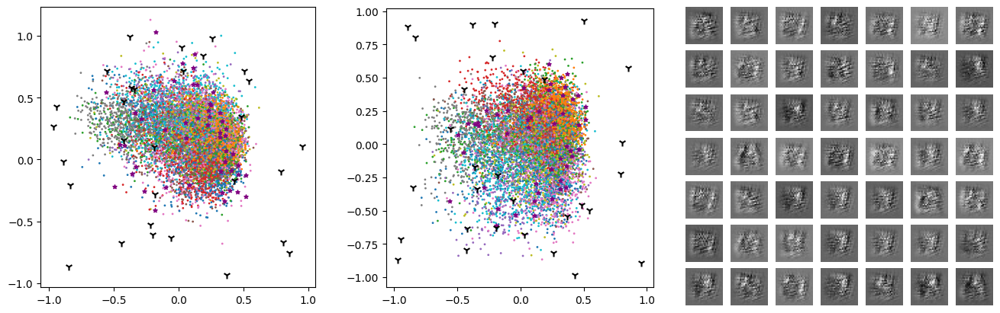

Epoch 0/300 AUC 0.7301886397574551


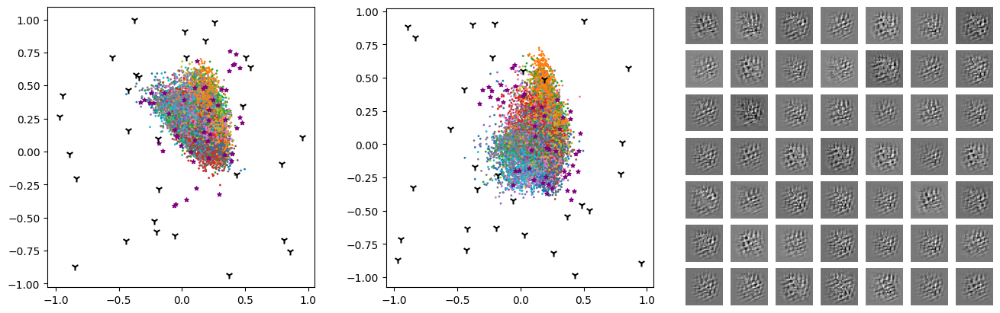

Epoch 3/300 AUC 0.5327544798407168


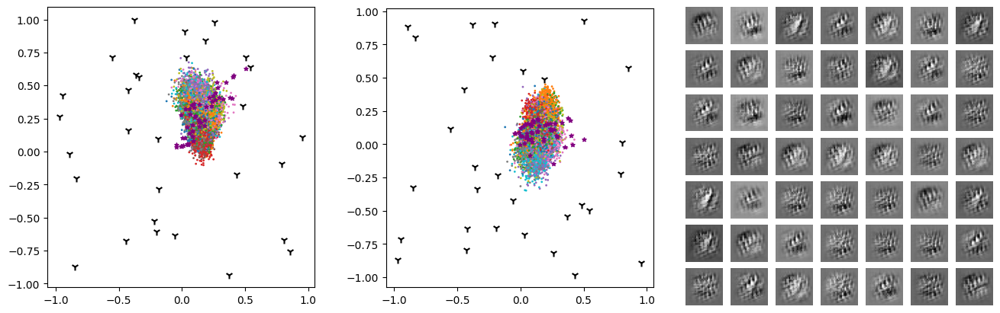

Epoch 6/300 AUC 0.5600313928232047


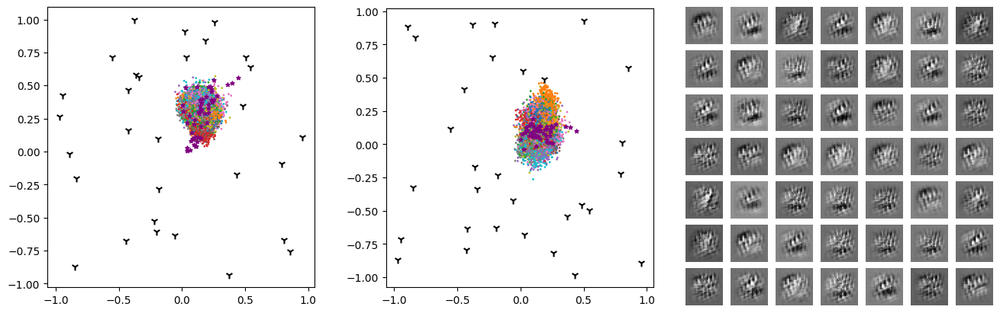

Epoch 9/300 AUC 0.594104427802163


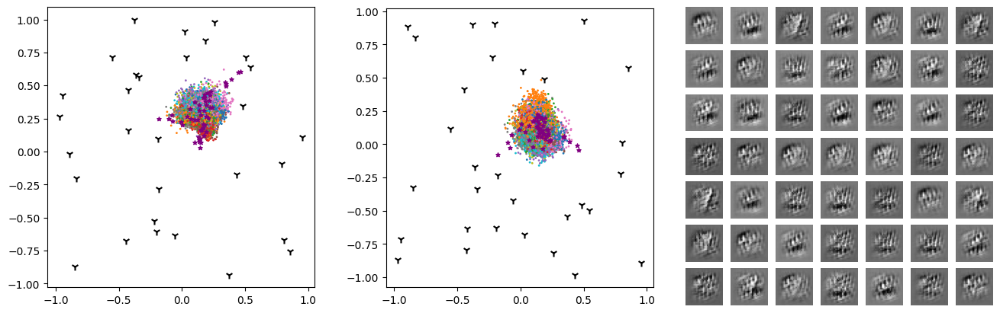

Epoch 12/300 AUC 0.5730343567582243


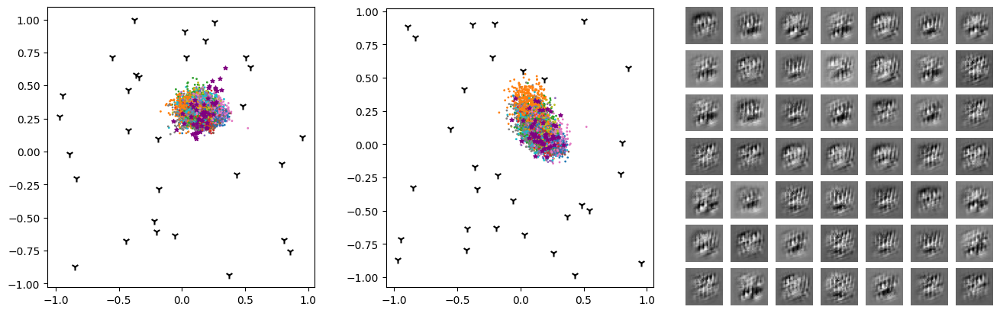

Epoch 15/300 AUC 0.48835959771935383


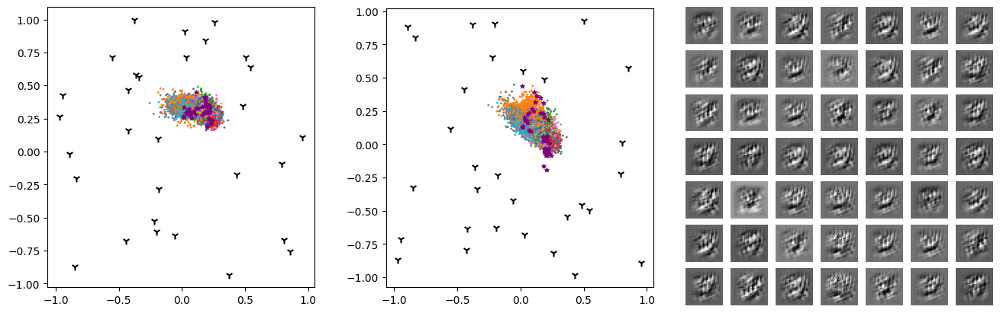

Epoch 18/300 AUC 0.5095332367980452


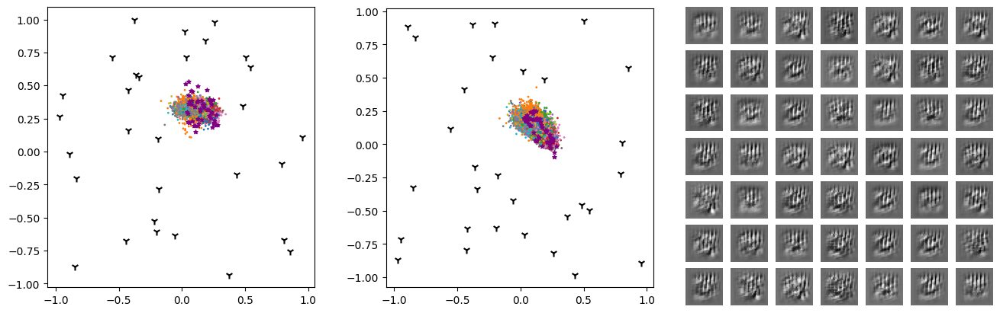

Epoch 21/300 AUC 0.48947610751617726


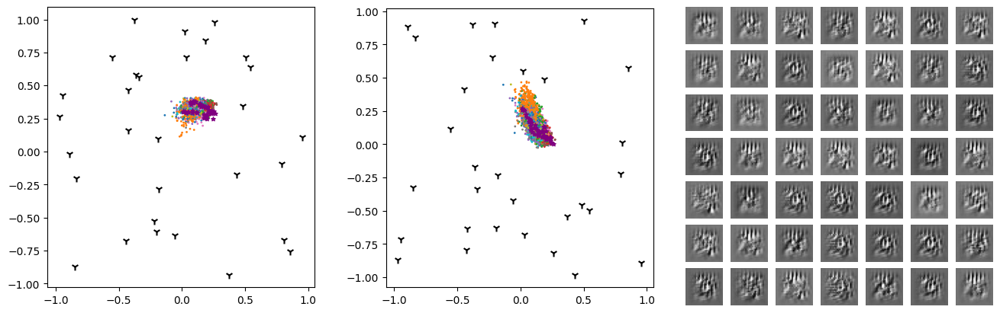

Epoch 24/300 AUC 0.4326962758495859


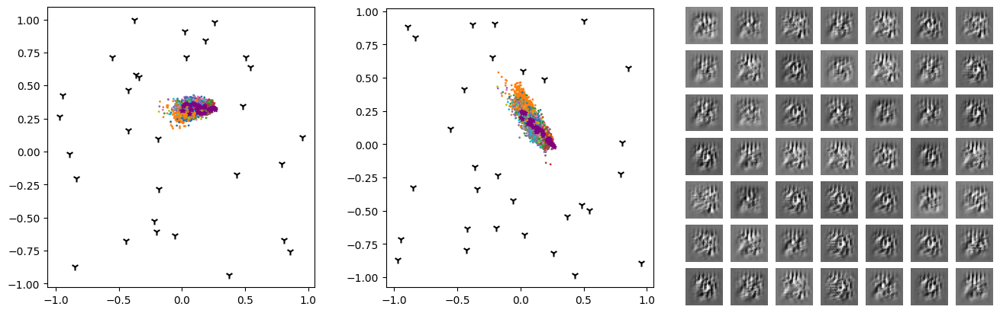

Epoch 27/300 AUC 0.43038378433413277


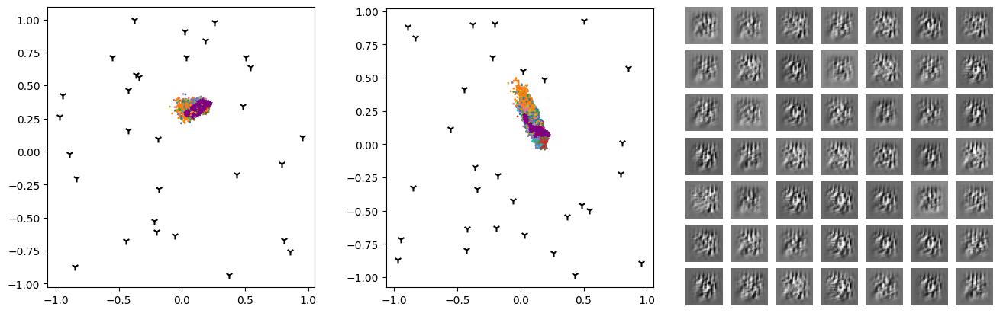

Epoch 30/300 AUC 0.4446754378026154


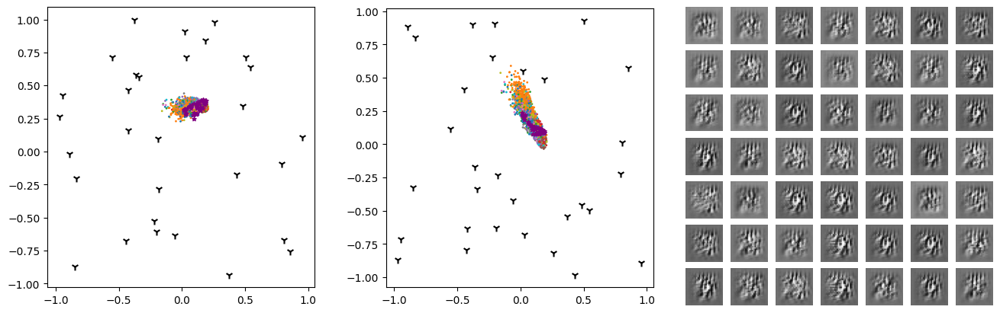

Epoch 33/300 AUC 0.45425528304448165


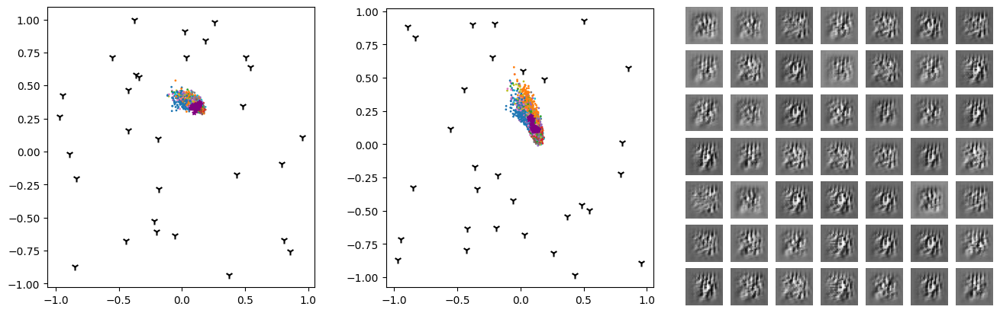

Epoch 36/300 AUC 0.4982158694963573


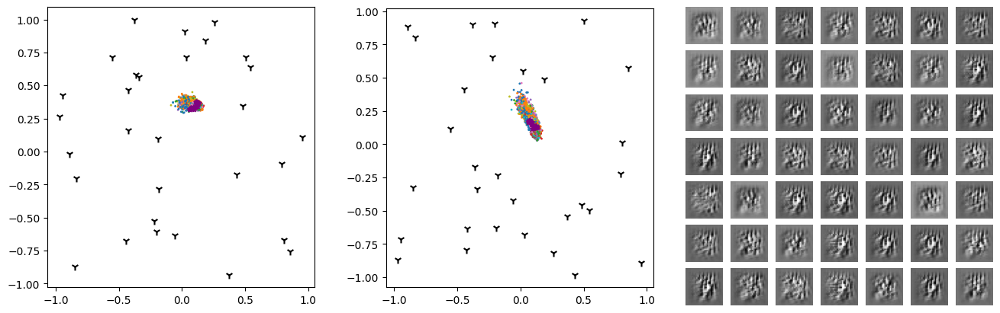

Epoch 39/300 AUC 0.5373056473143581


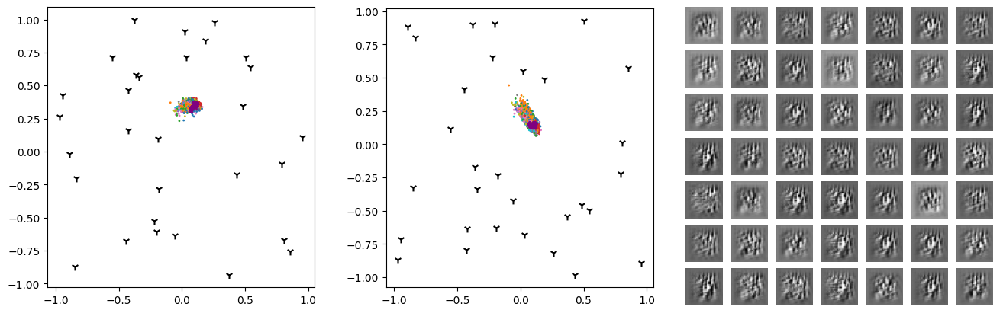

Epoch 42/300 AUC 0.5199602357572741


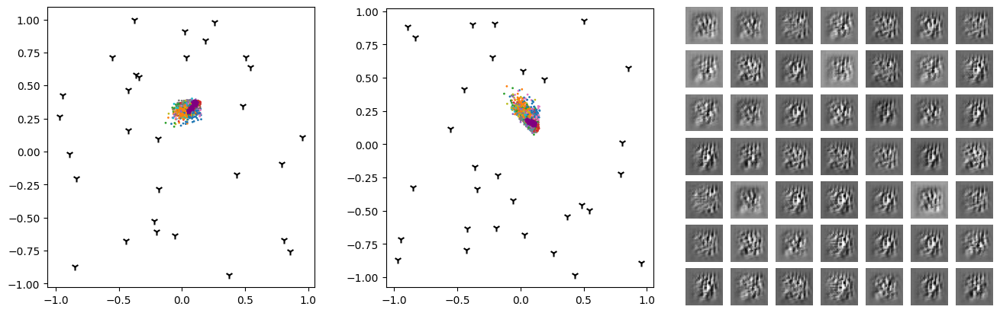

Epoch 45/300 AUC 0.5506337390832164


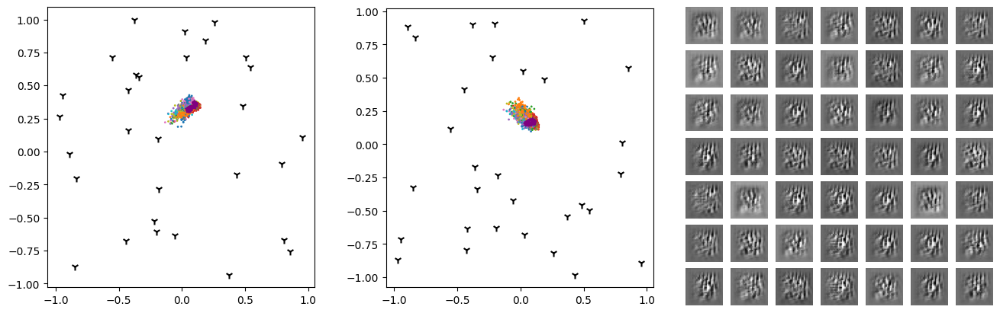

Epoch 48/300 AUC 0.5625914634146342


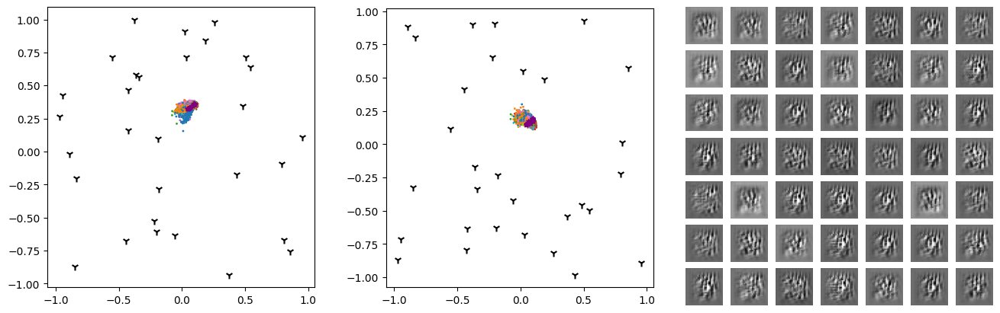

Epoch 51/300 AUC 0.5725648785012897


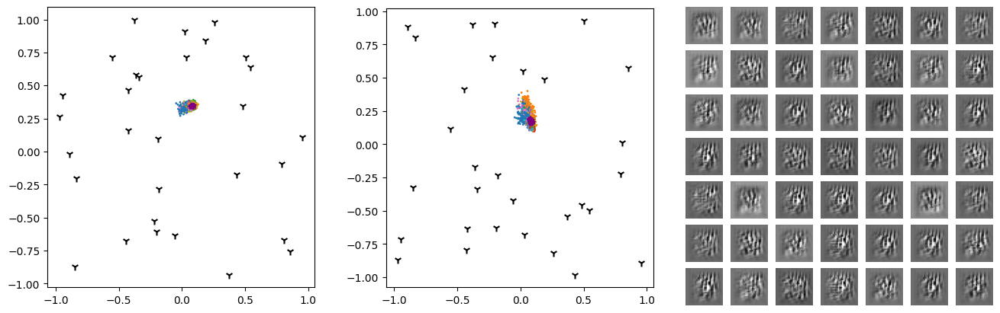

Epoch 54/300 AUC 0.5658995882166614


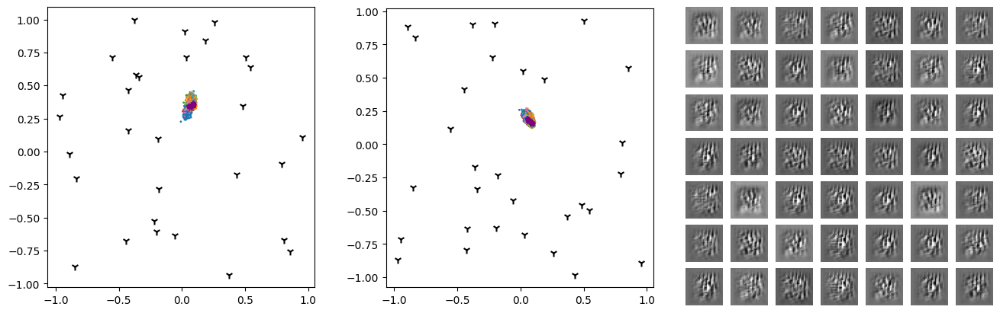

Epoch 57/300 AUC 0.5499735847775917


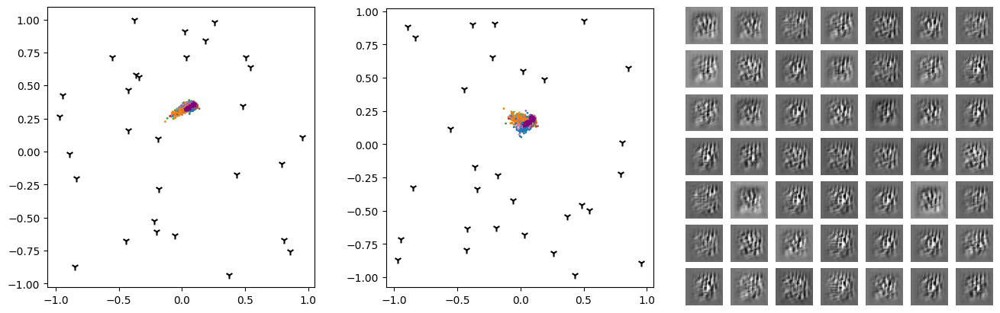

Epoch 60/300 AUC 0.5034982917779085


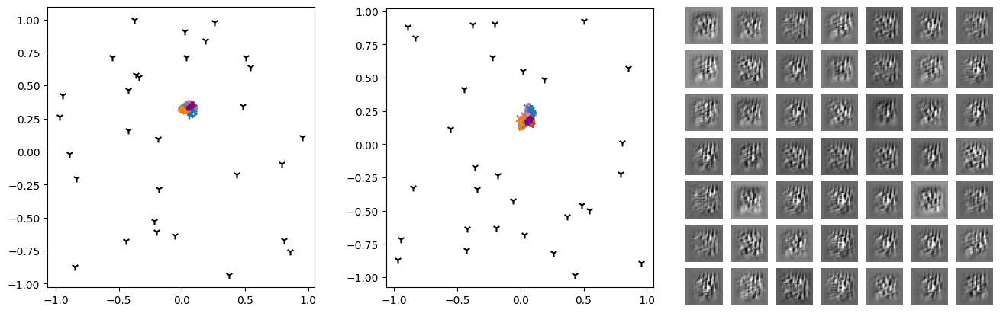

Epoch 63/300 AUC 0.5945613489298158


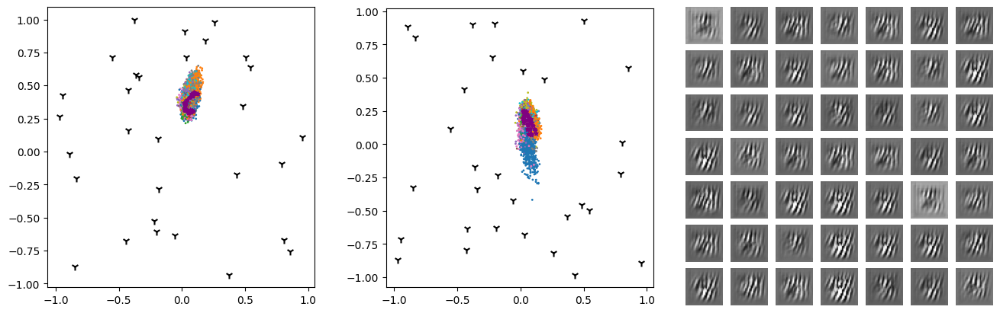

Epoch 66/300 AUC 0.449699703606498


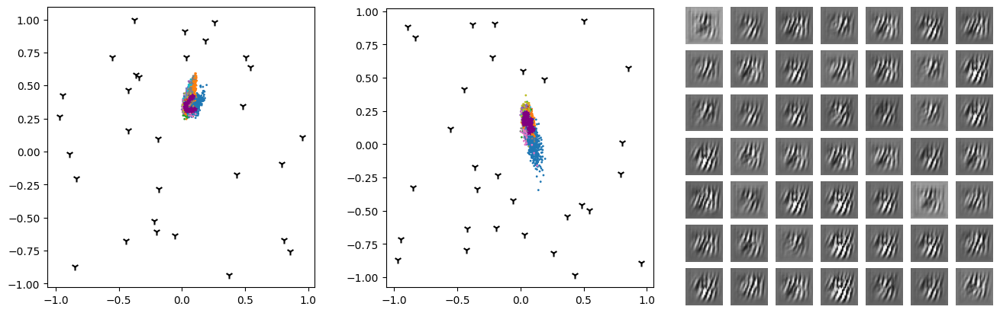

Epoch 69/300 AUC 0.46014327571383323


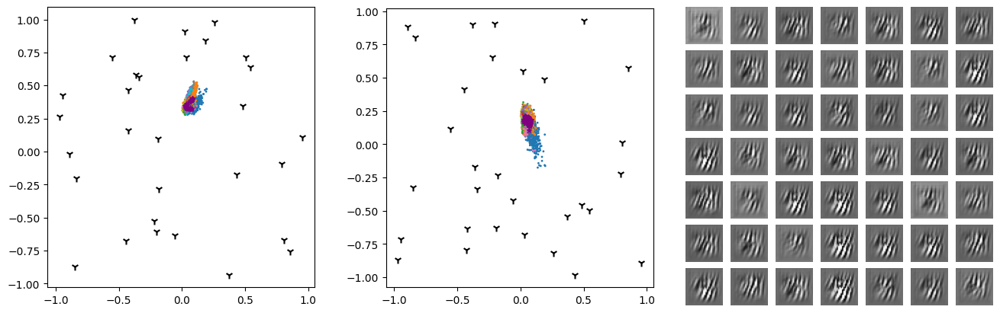

Epoch 72/300 AUC 0.47797903751300963


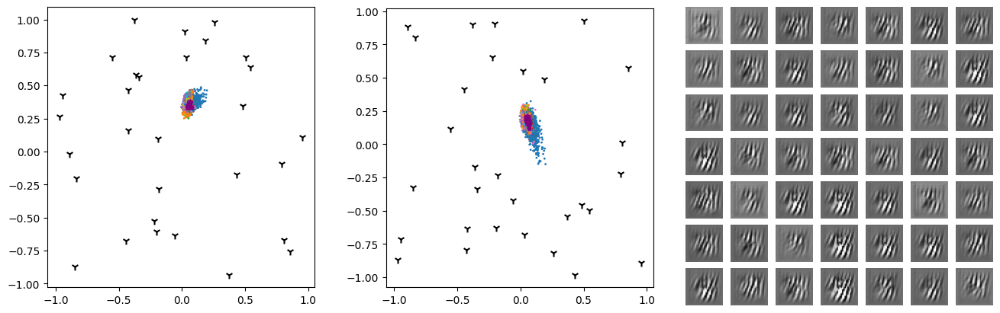

Epoch 75/300 AUC 0.4824218290420381


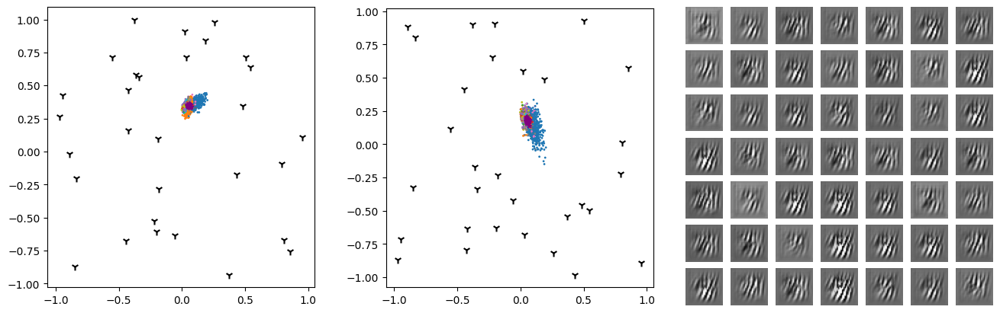

Epoch 78/300 AUC 0.44275244354948184


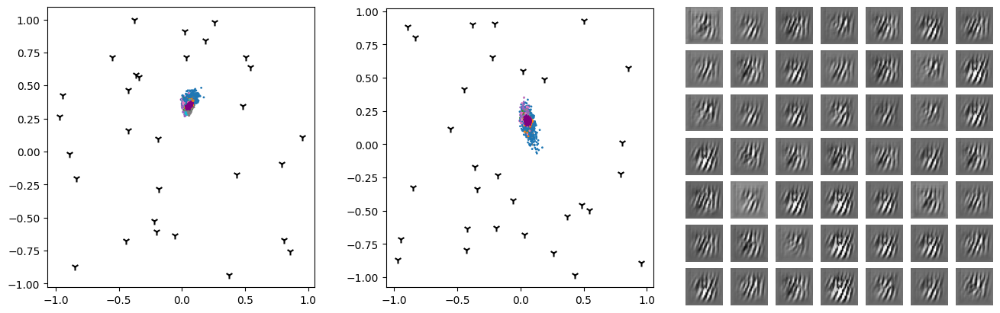

Epoch 81/300 AUC 0.45962769808588627


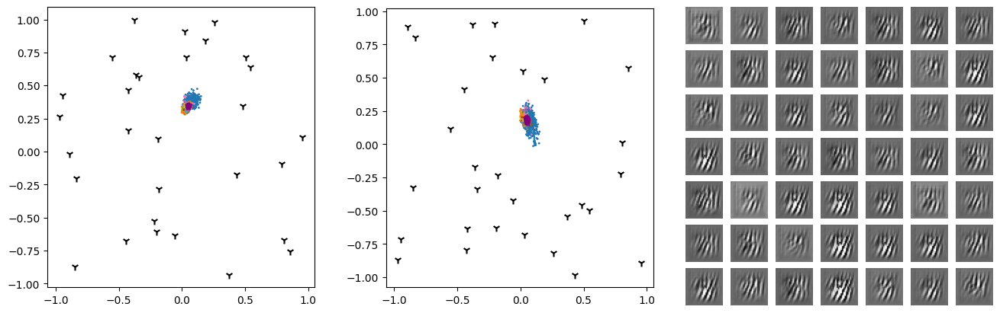

Epoch 84/300 AUC 0.48733879361057053


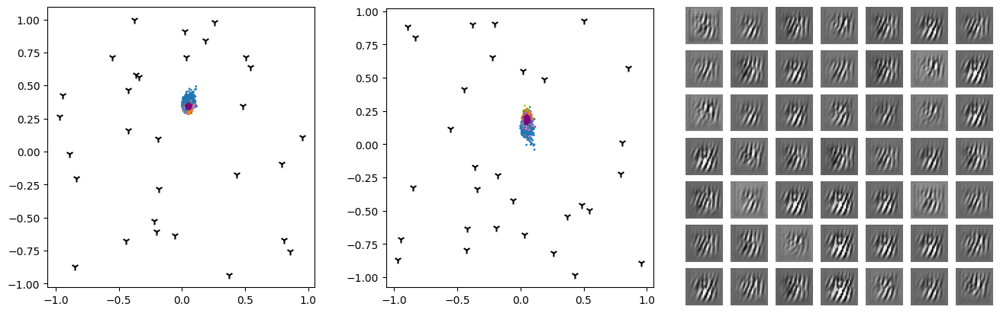

Epoch 87/300 AUC 0.546048916240554


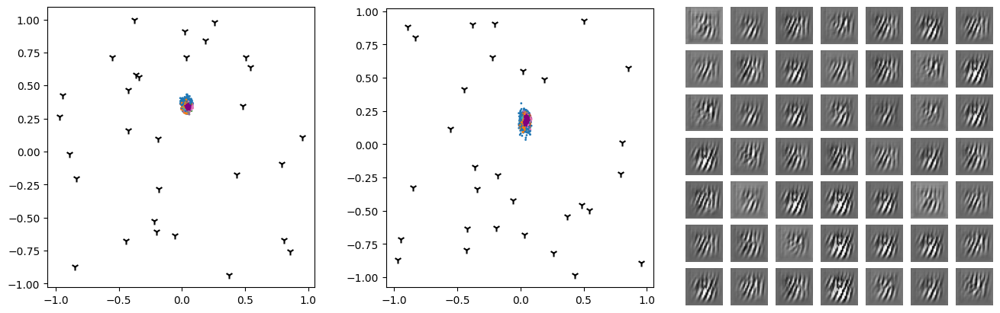

Epoch 90/300 AUC 0.475894610615865


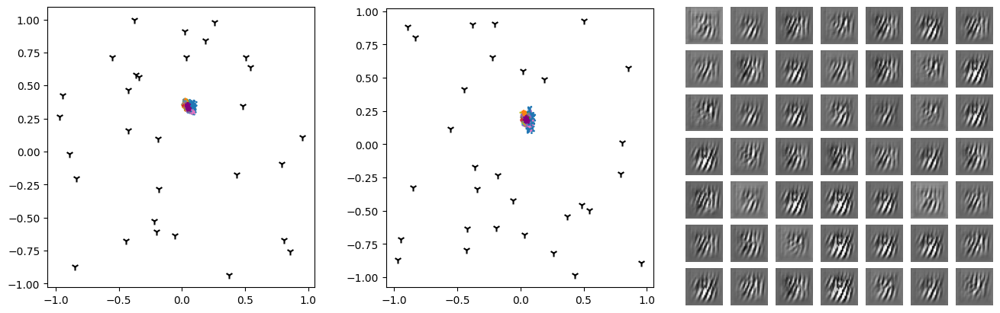

Epoch 93/300 AUC 0.4504758133852211


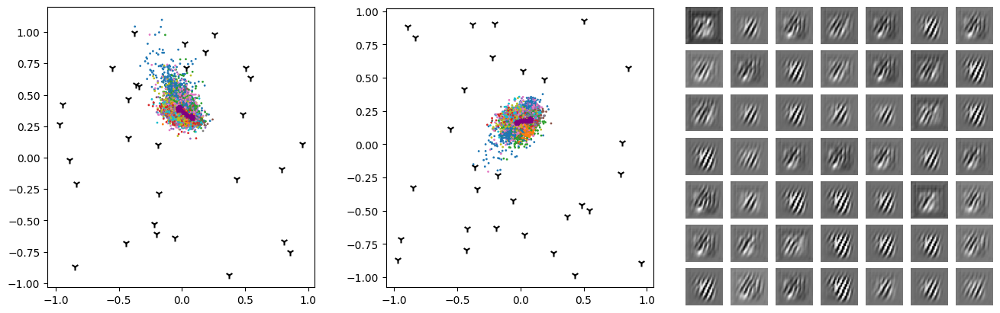

Epoch 96/300 AUC 0.6262255645051813


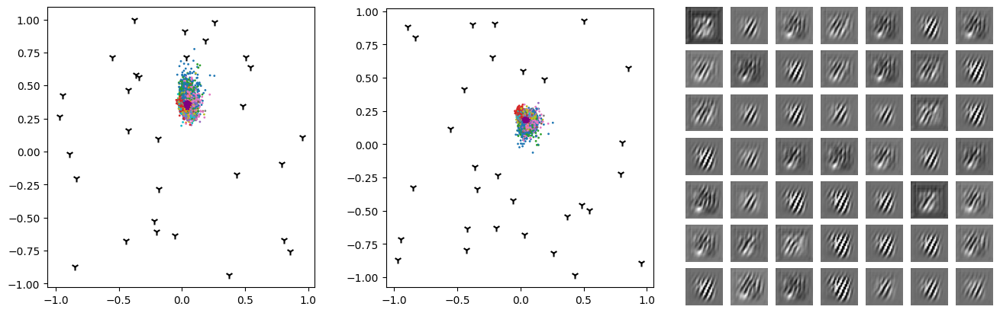

Epoch 99/300 AUC 0.5802482578397212


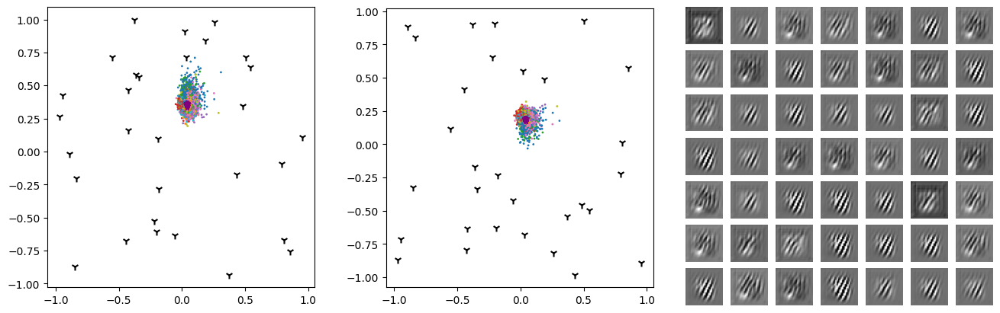

Epoch 102/300 AUC 0.5821550183266212


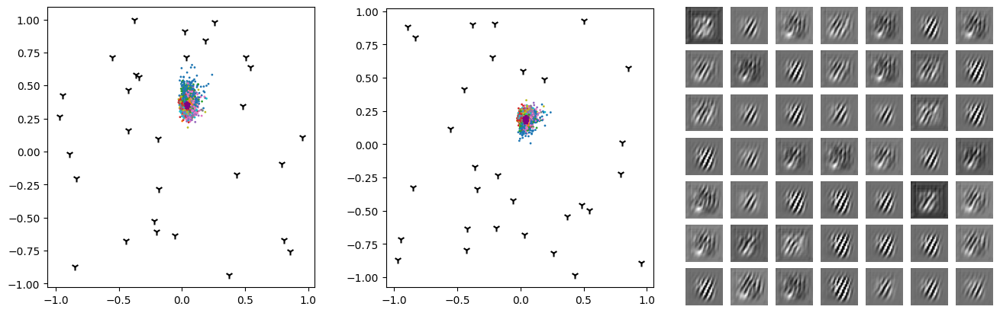

Epoch 105/300 AUC 0.5745122516855966


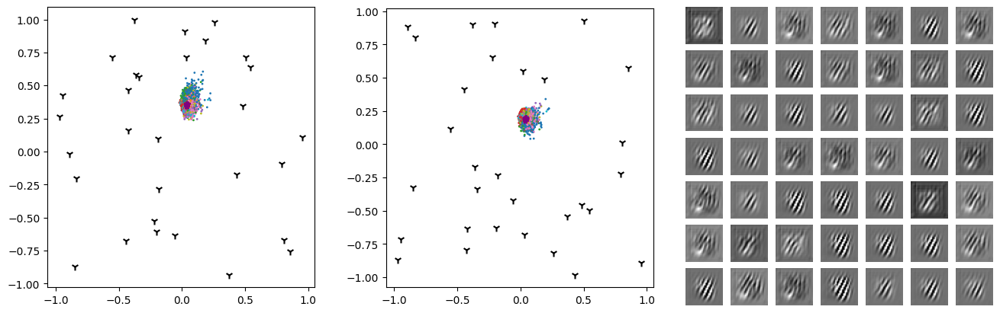

Epoch 108/300 AUC 0.5570066518847007


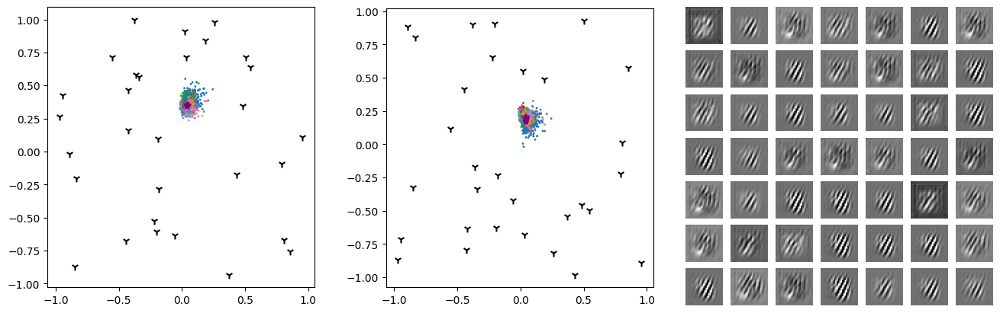

Epoch 111/300 AUC 0.5700125005656365


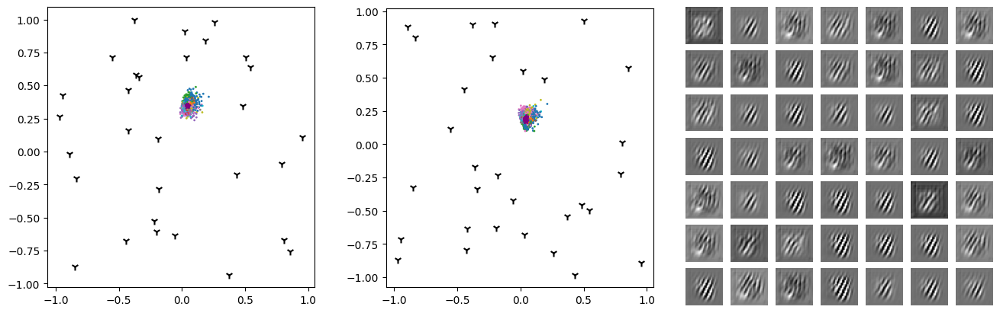

Epoch 114/300 AUC 0.5349236390786913


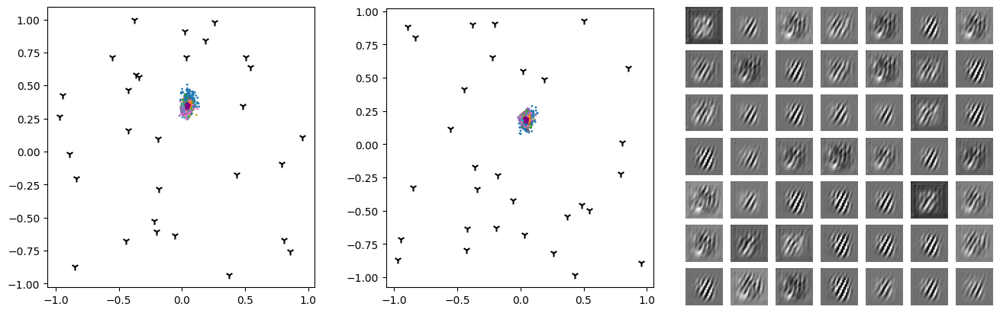

Epoch 117/300 AUC 0.5663148219376442


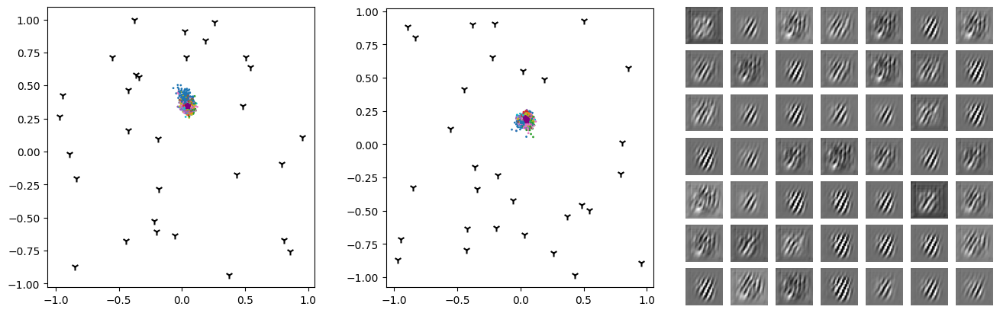

Epoch 120/300 AUC 0.5499895922892438


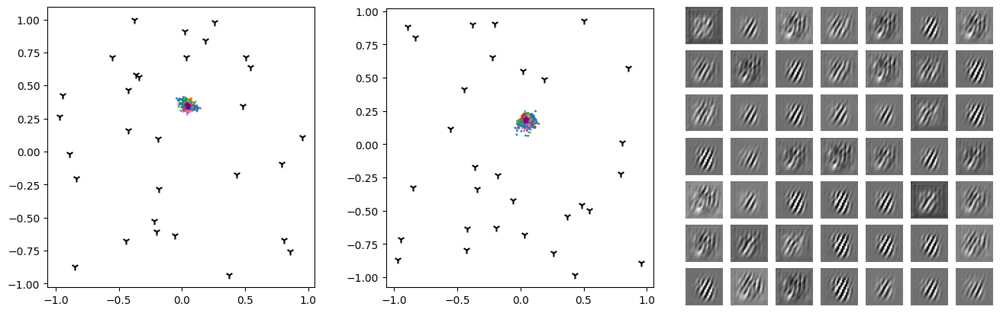

Epoch 123/300 AUC 0.5353914204262636


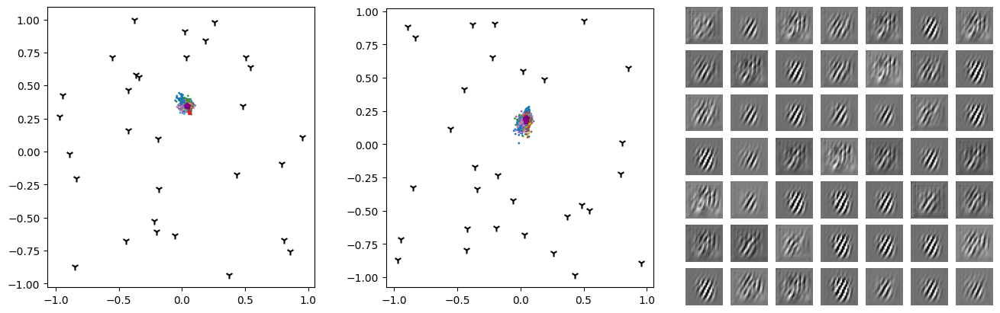

Epoch 126/300 AUC 0.5116848613059415


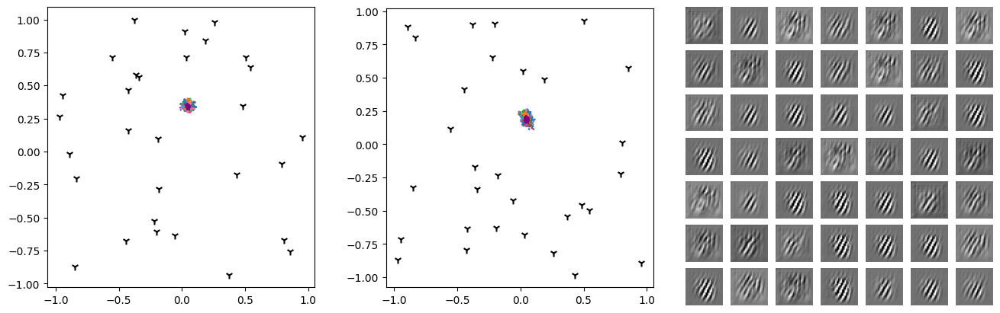

Epoch 129/300 AUC 0.43561999411738084


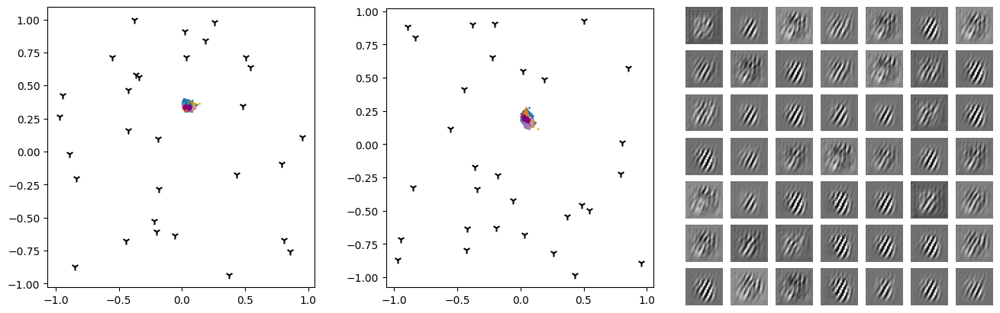

Epoch 132/300 AUC 0.3942193651296439


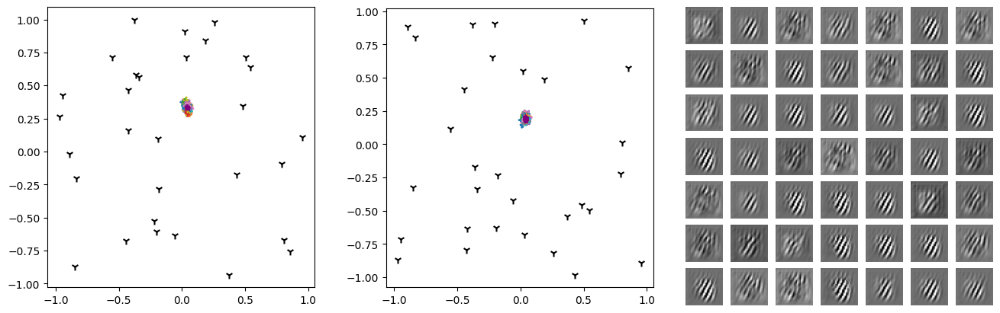

Epoch 135/300 AUC 0.500063690664736


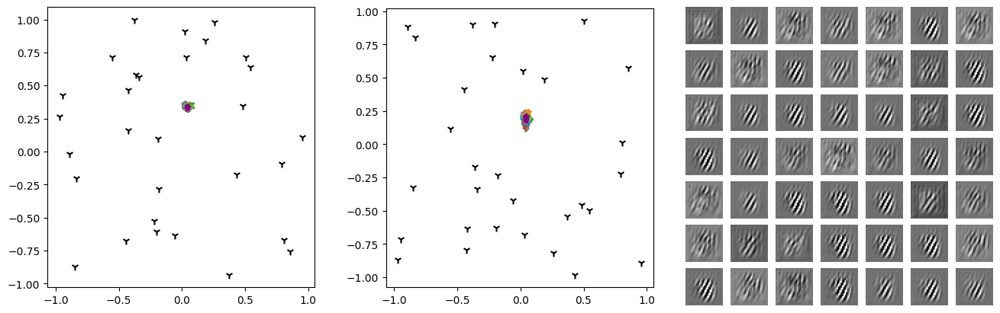

Epoch 138/300 AUC 0.4134483460790081


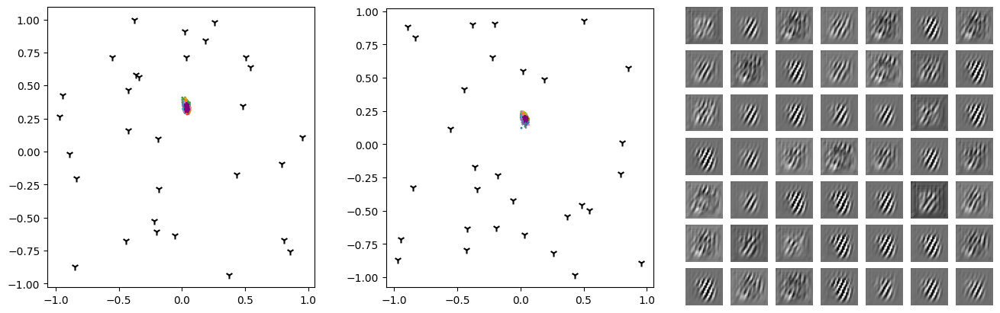

Epoch 141/300 AUC 0.3947930336214308


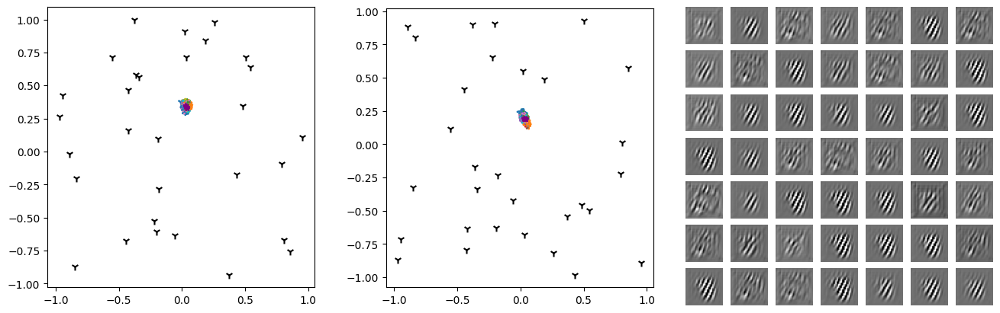

Epoch 144/300 AUC 0.6197113557174533


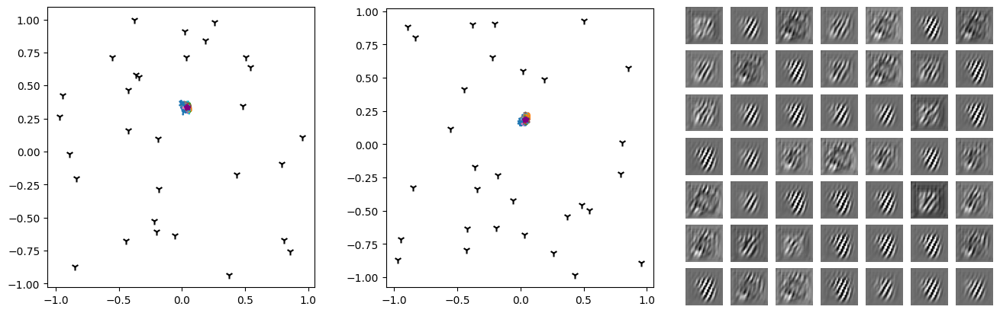

Epoch 147/300 AUC 0.5440672654871261


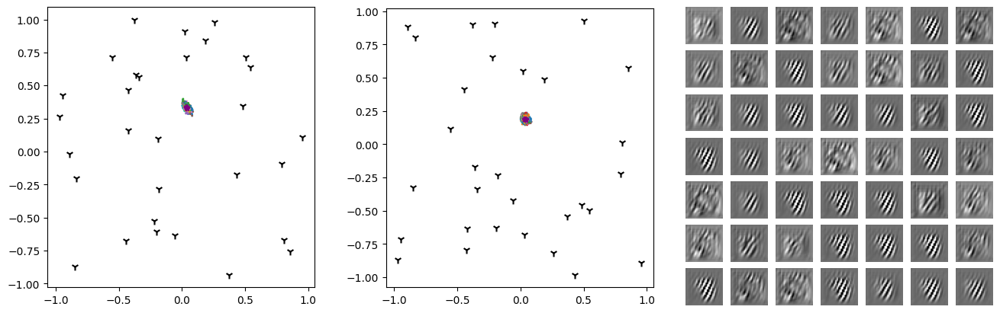

Epoch 150/300 AUC 0.4866338974614236


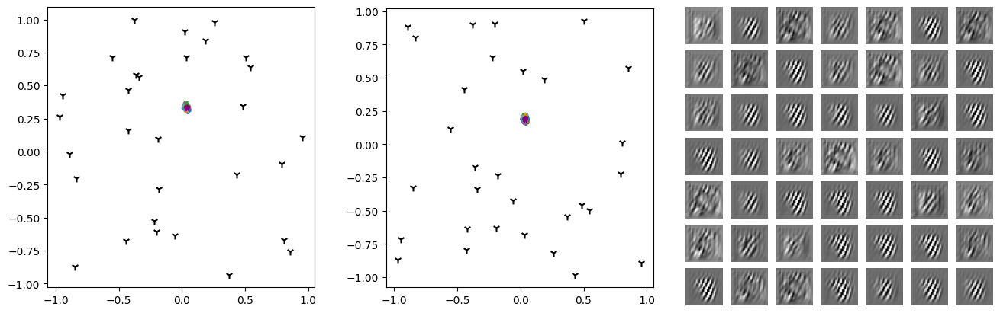

Epoch 153/300 AUC 0.48042281324946834


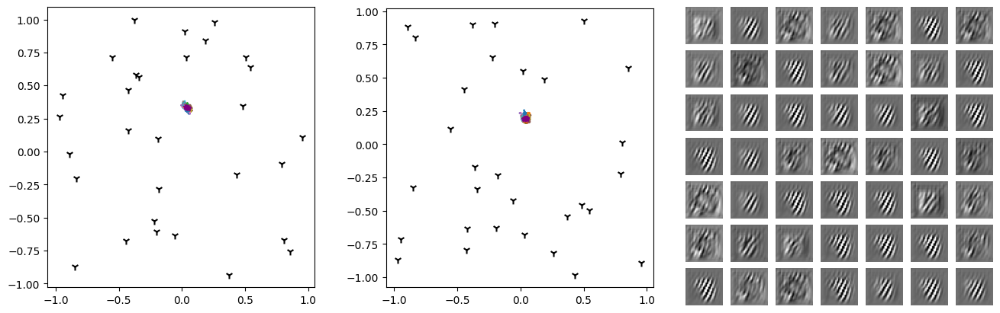

Epoch 156/300 AUC 0.5170585773111905


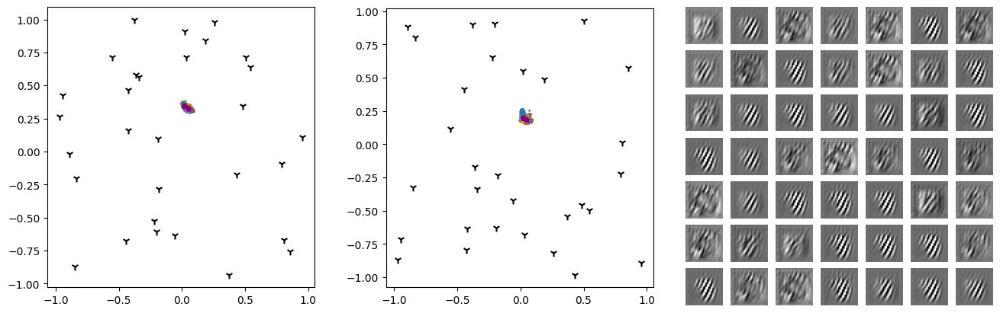

Epoch 159/300 AUC 0.5294677926603014


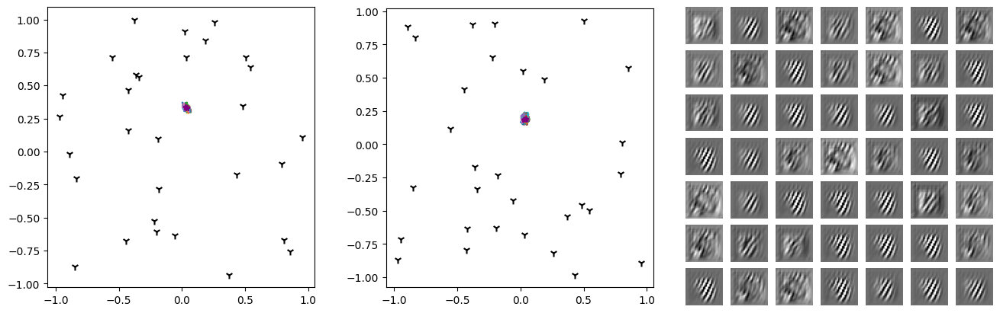

Epoch 162/300 AUC 0.5479603149463776


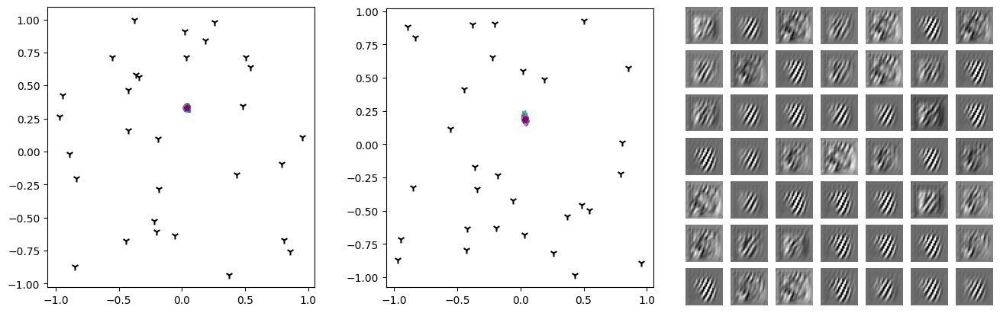

Epoch 165/300 AUC 0.4921374270328974


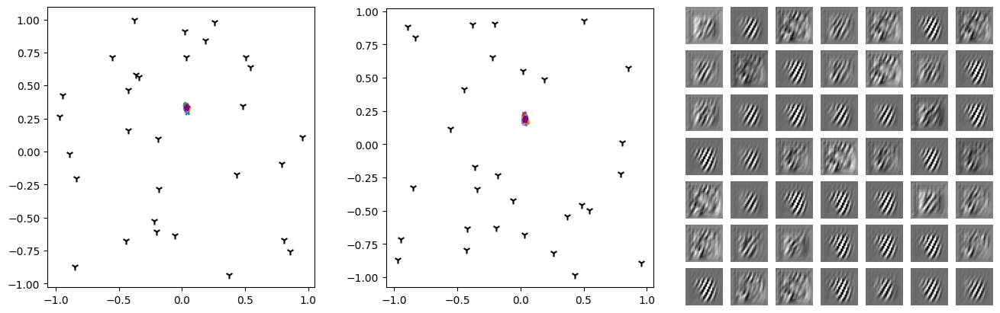

Epoch 168/300 AUC 0.5518175596180823


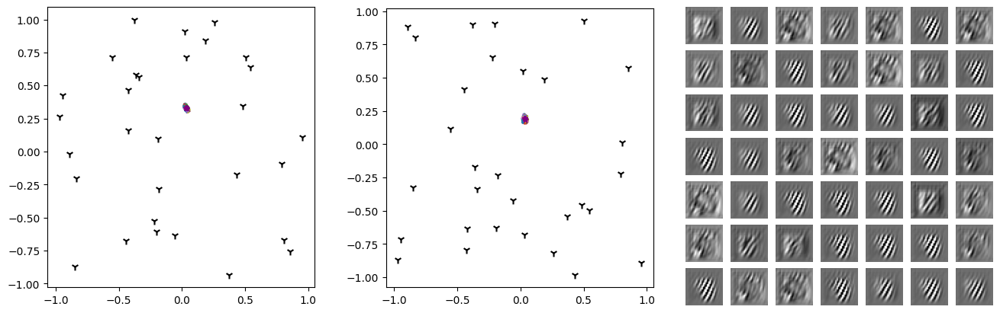

Epoch 171/300 AUC 0.48890198651522687


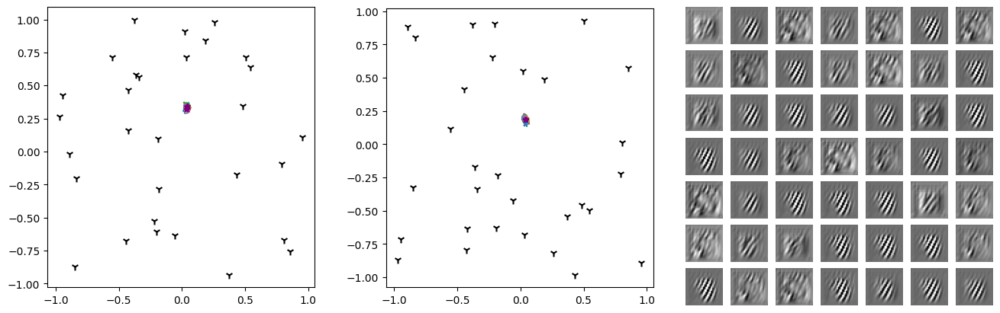

Epoch 174/300 AUC 0.4757648536132857


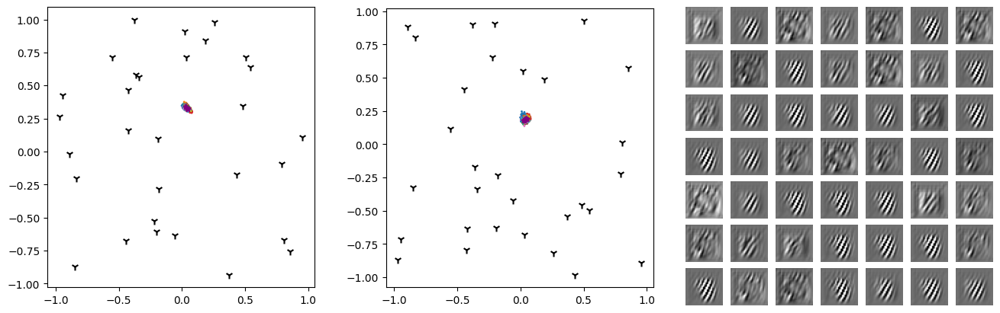

Epoch 177/300 AUC 0.5384670120819947


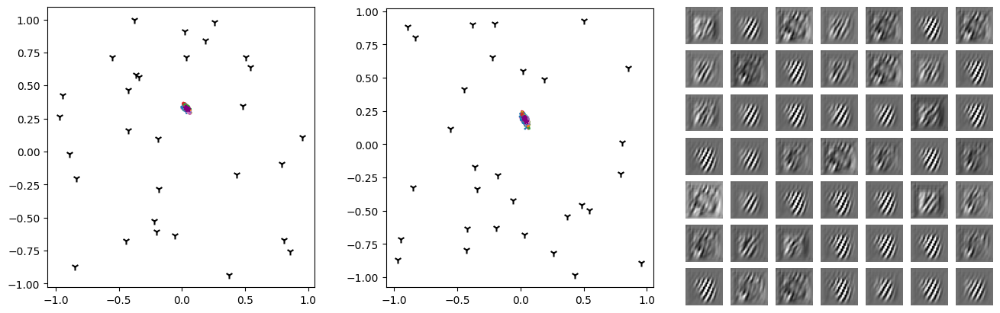

Epoch 180/300 AUC 0.5855790986017466


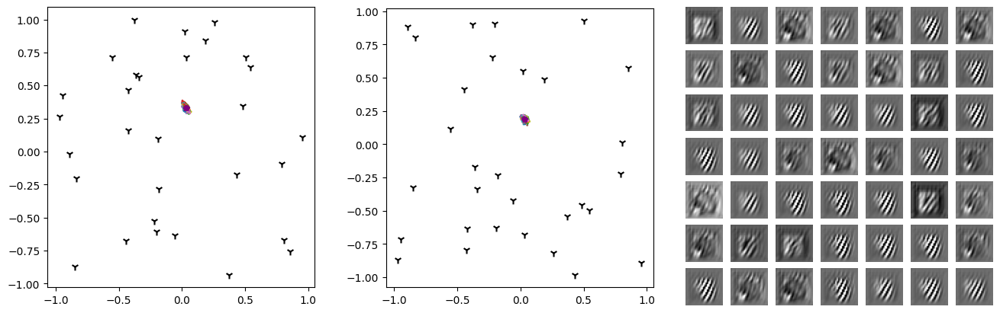

Epoch 183/300 AUC 0.5903070840309516


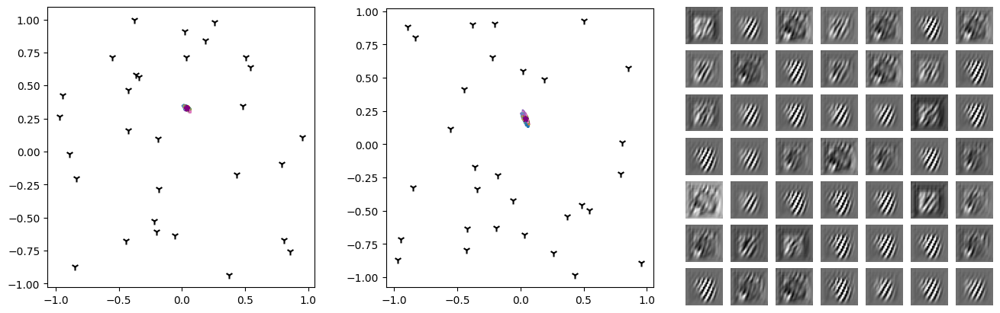

Epoch 186/300 AUC 0.5047222725010182


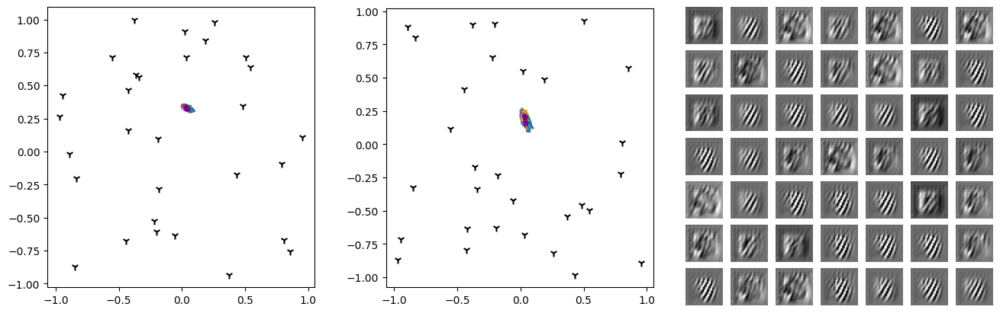

Epoch 189/300 AUC 0.40245893479342953


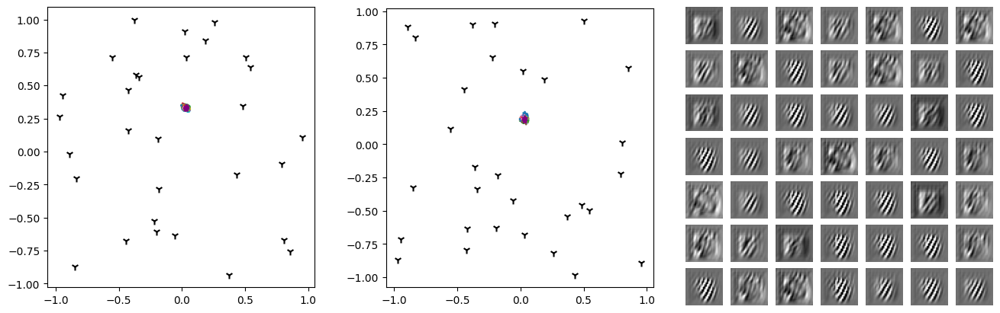

Epoch 192/300 AUC 0.5421658219828951


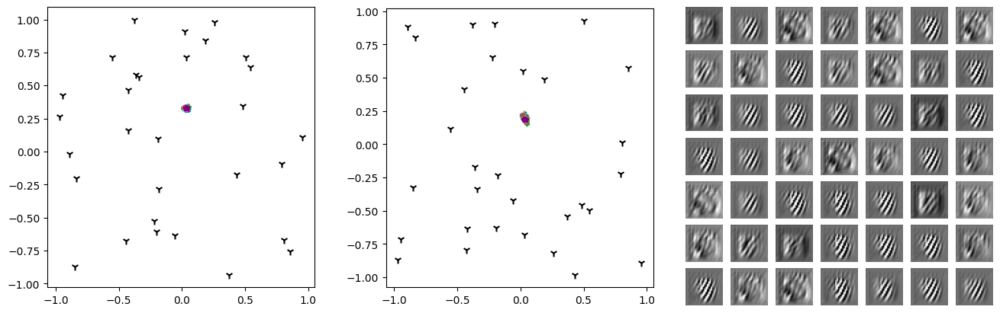

Epoch 195/300 AUC 0.508367969138875


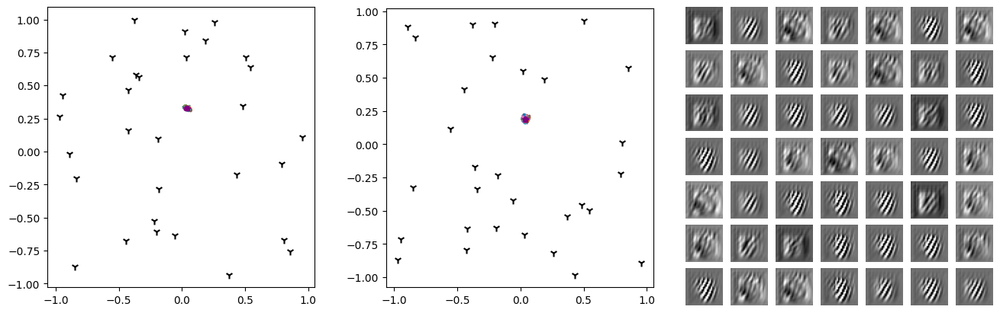

Epoch 198/300 AUC 0.5666423254445903


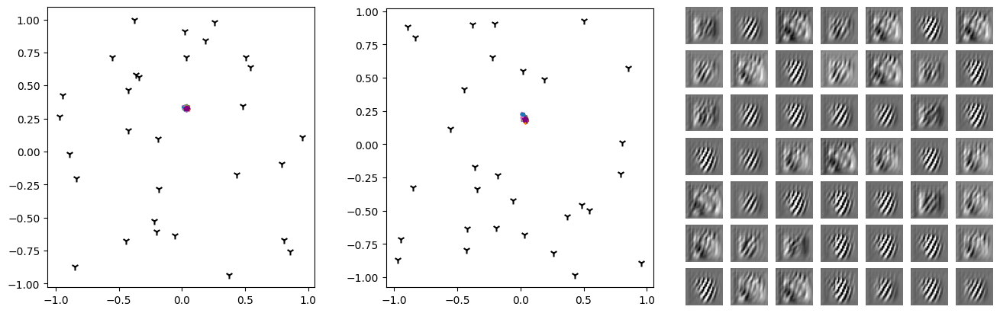

Epoch 201/300 AUC 0.5980199330286439


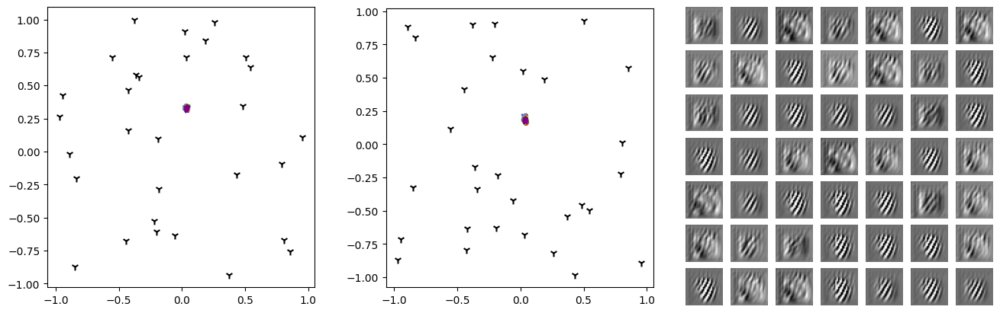

Epoch 204/300 AUC 0.555519141137608


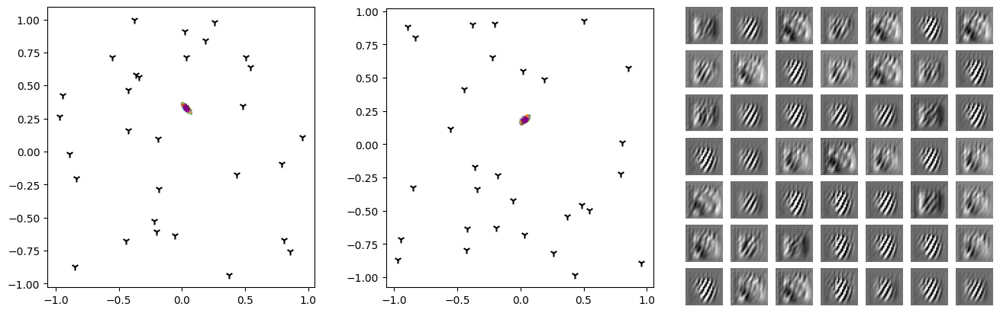

Epoch 207/300 AUC 0.5966979275080321


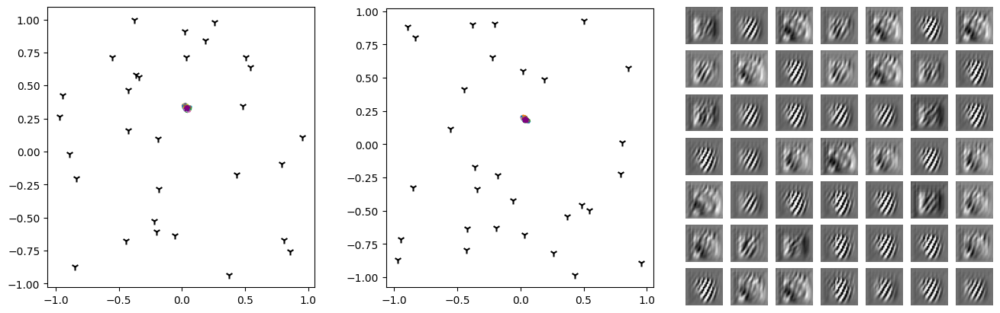

Epoch 210/300 AUC 0.5898400945744151


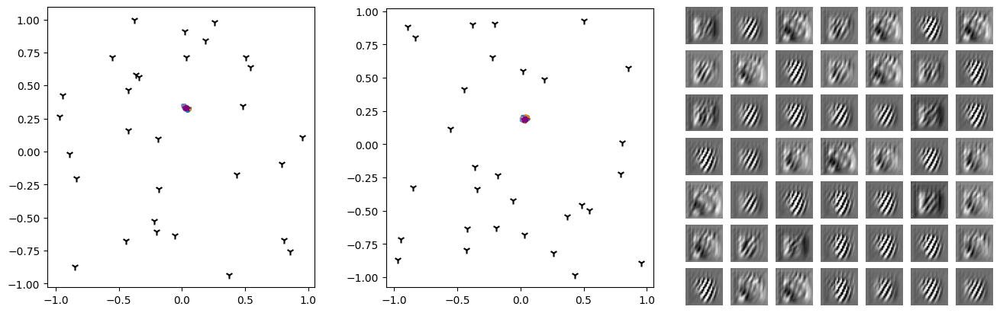

Epoch 213/300 AUC 0.5837898208063714


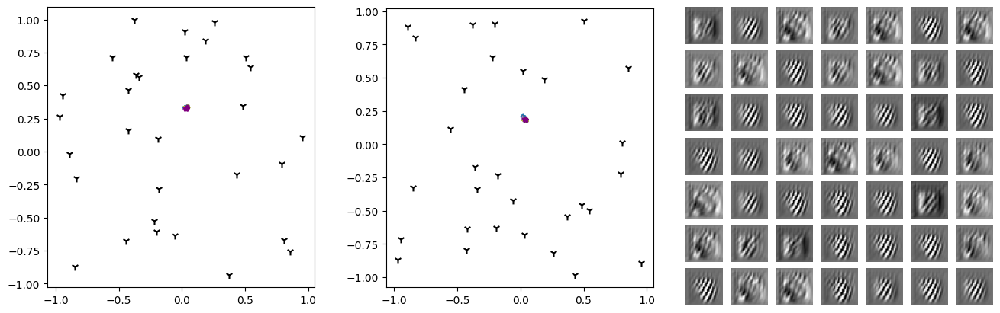

Epoch 216/300 AUC 0.5922239128467351


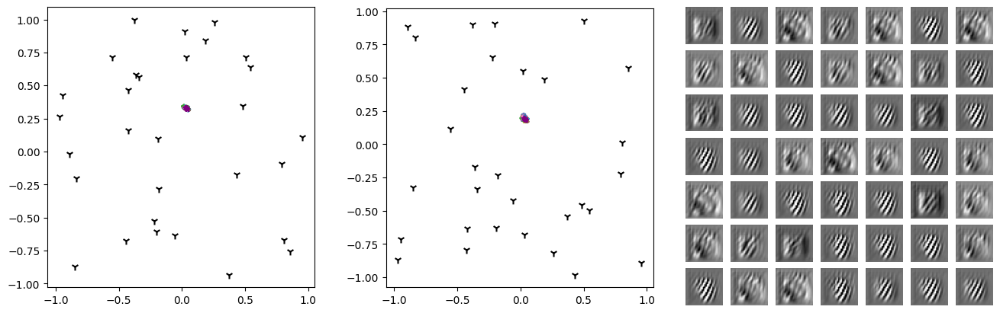

Epoch 219/300 AUC 0.6027397167292637


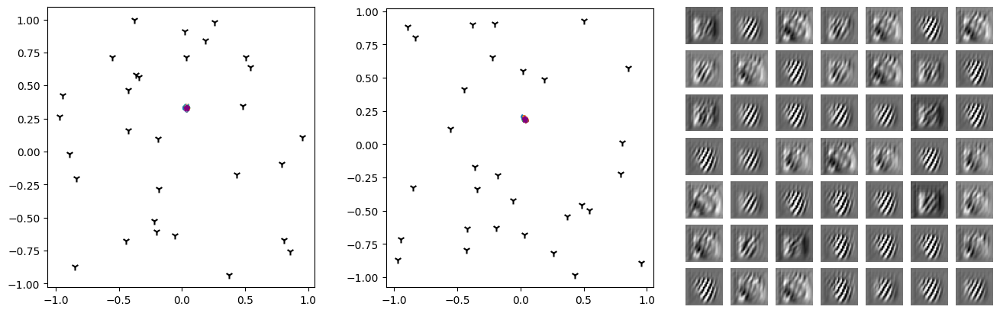

Epoch 222/300 AUC 0.5279055613376171


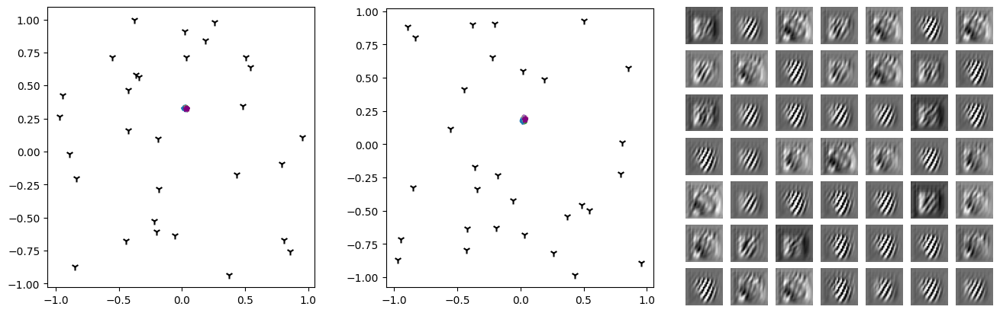

Epoch 225/300 AUC 0.5165829901805512


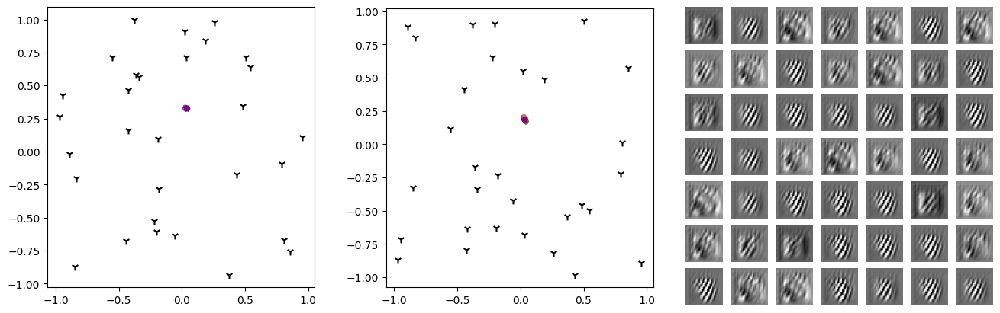

Epoch 228/300 AUC 0.5266527331553464


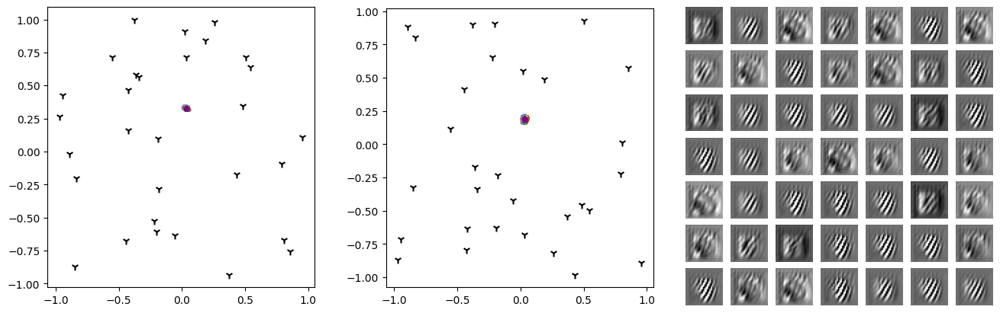

Epoch 231/300 AUC 0.5674292954432327


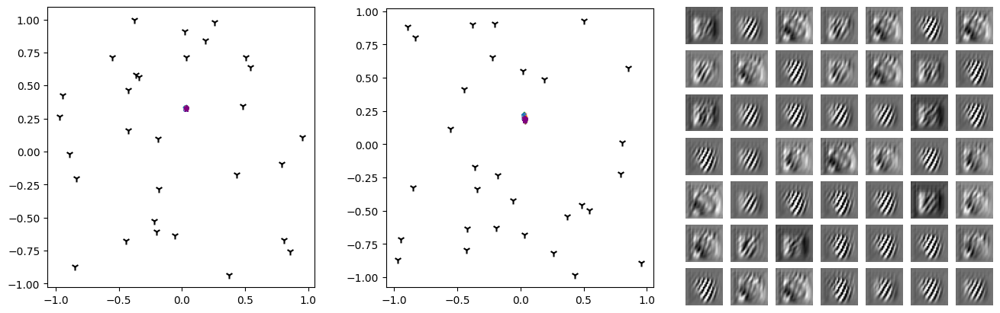

Epoch 234/300 AUC 0.570092934069415


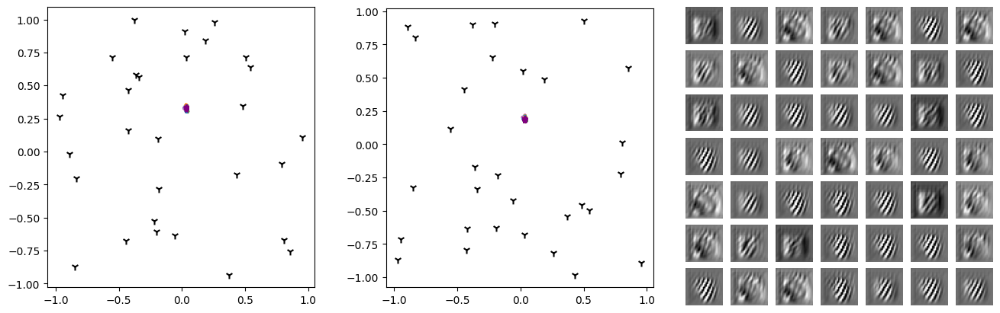

Epoch 237/300 AUC 0.5423585908864654


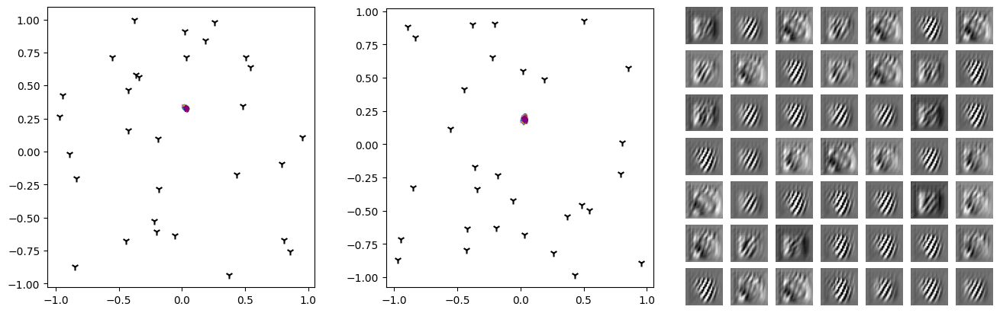

Epoch 240/300 AUC 0.5160484637313906


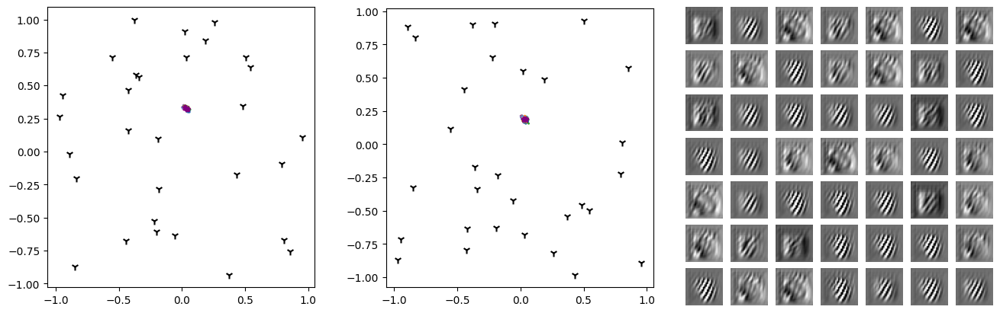

Epoch 243/300 AUC 0.4909058667813023


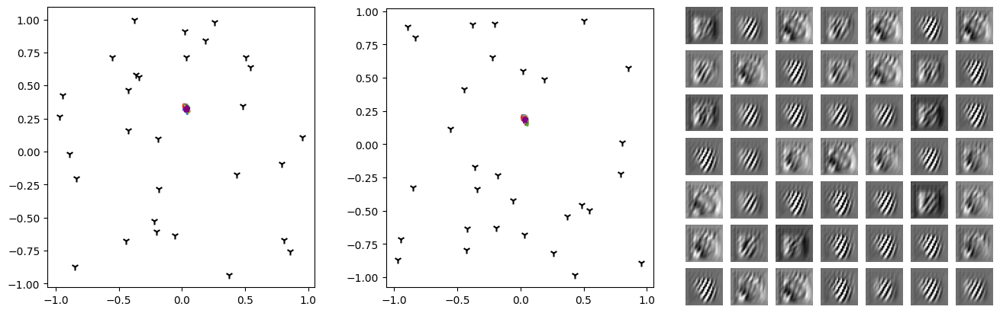

Epoch 246/300 AUC 0.6004849201321327


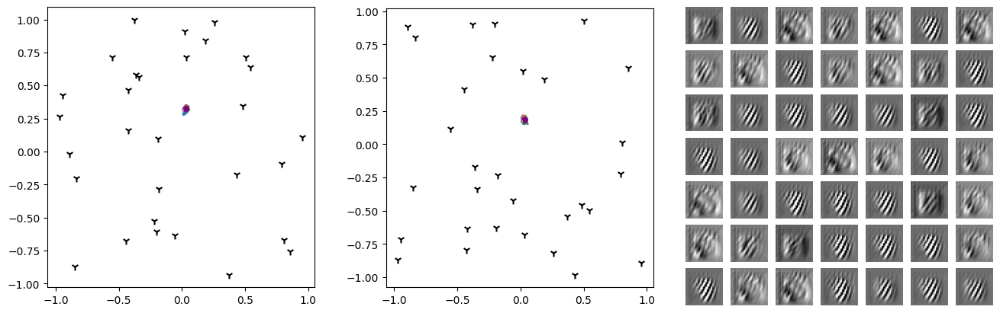

Epoch 249/300 AUC 0.5386187157789945


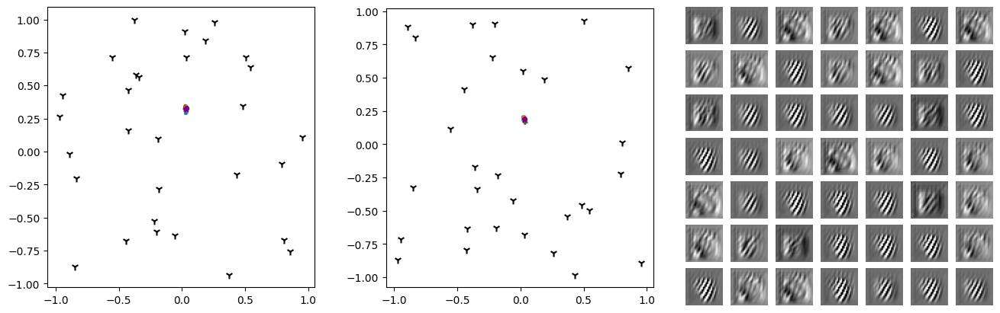

Epoch 252/300 AUC 0.5666561835377166


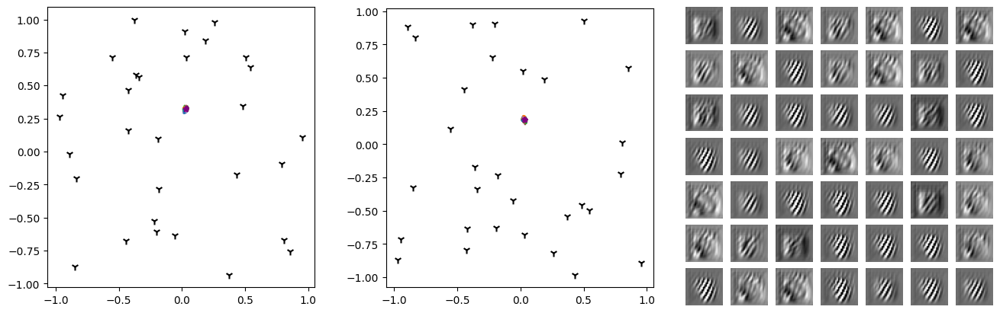

Epoch 255/300 AUC 0.5896218720304086


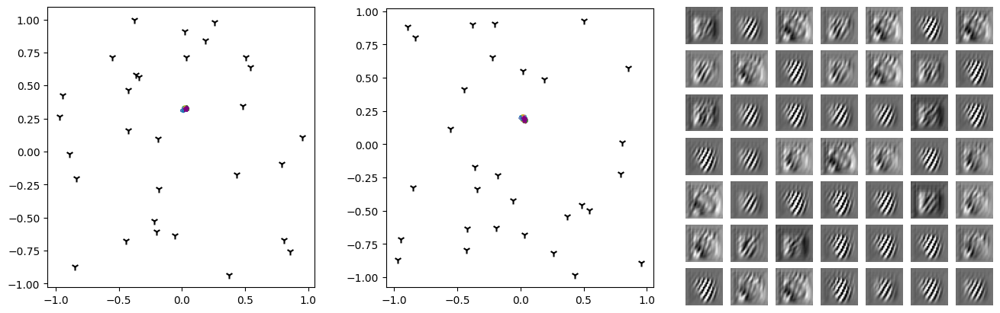

Epoch 258/300 AUC 0.6051139191818634


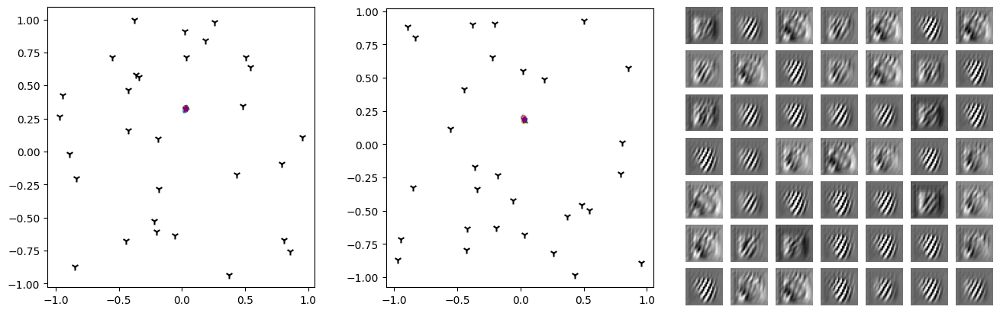

Epoch 261/300 AUC 0.6099032761663424


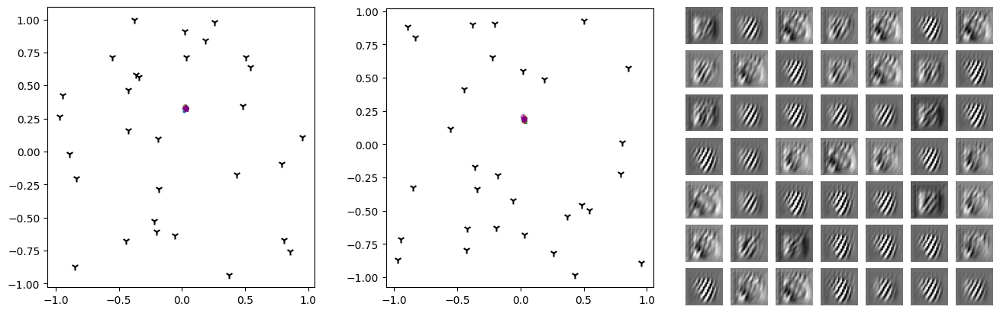

Epoch 264/300 AUC 0.6012203606498031


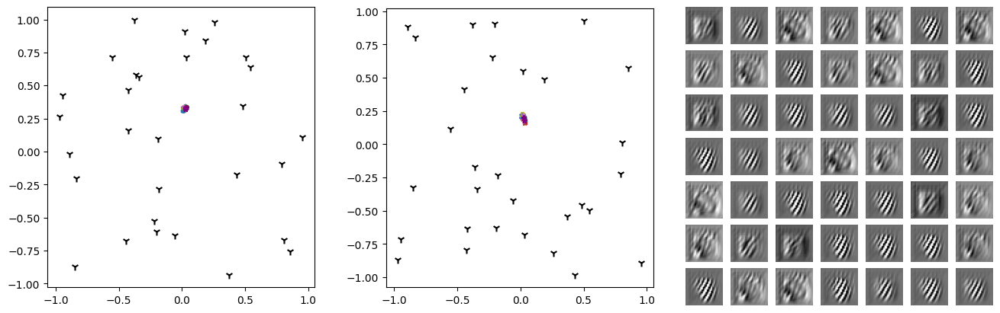

Epoch 267/300 AUC 0.6062113670301823


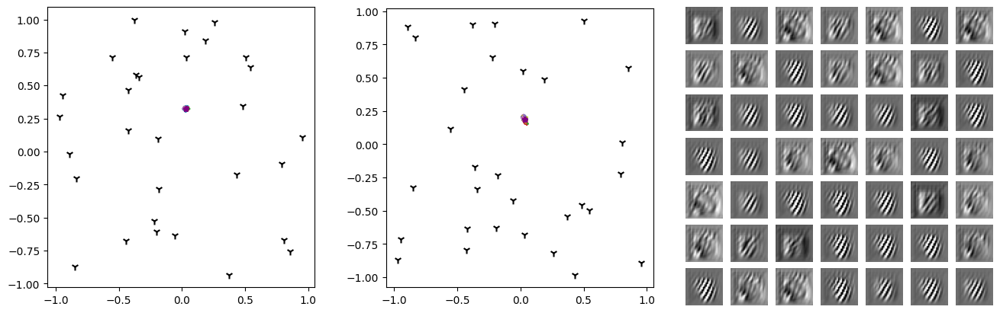

Epoch 270/300 AUC 0.5889717860536676


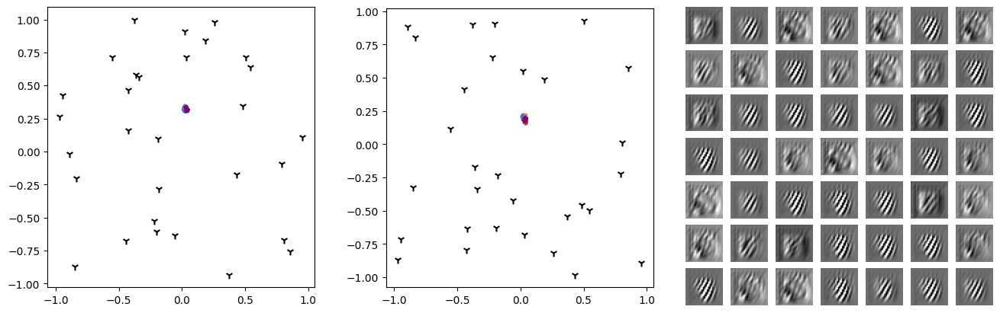

Epoch 273/300 AUC 0.6204681207294447


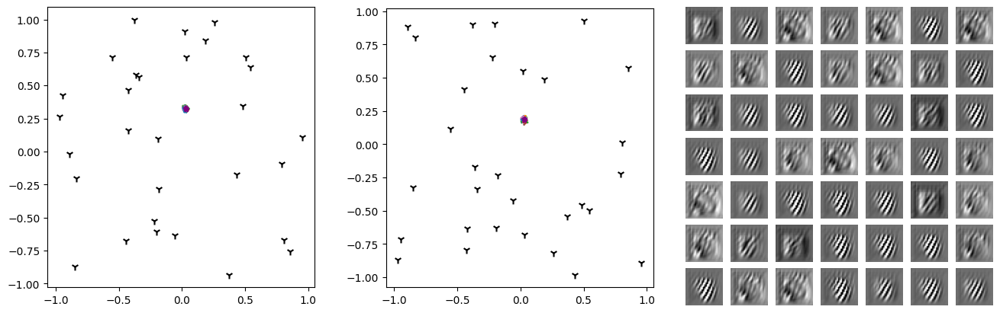

Epoch 276/300 AUC 0.5793066993981628


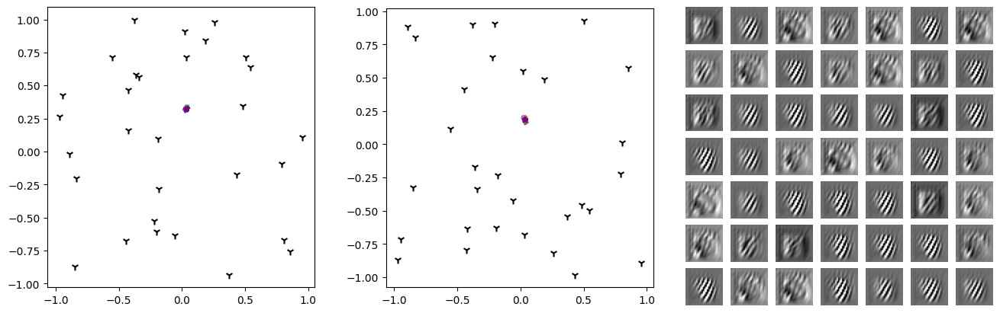

Epoch 279/300 AUC 0.5771270758857867


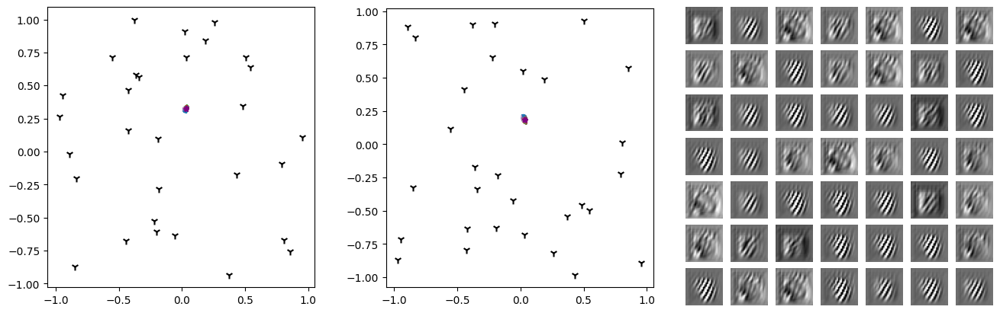

Epoch 282/300 AUC 0.6412988144259921


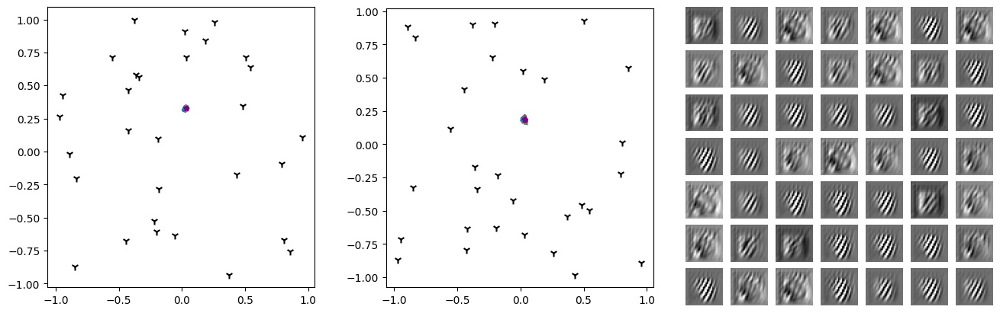

Epoch 285/300 AUC 0.617182621385583


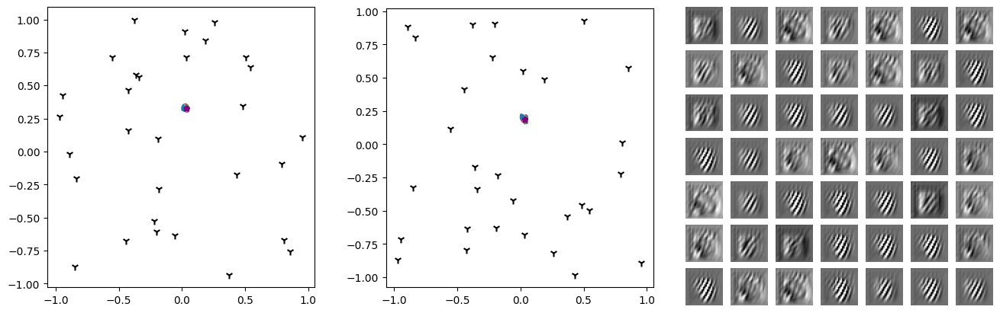

Epoch 288/300 AUC 0.6439965043667134


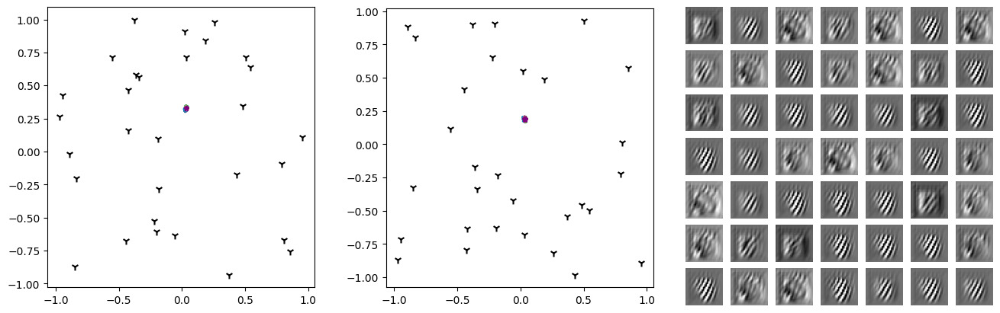

Epoch 291/300 AUC 0.6343192565274447


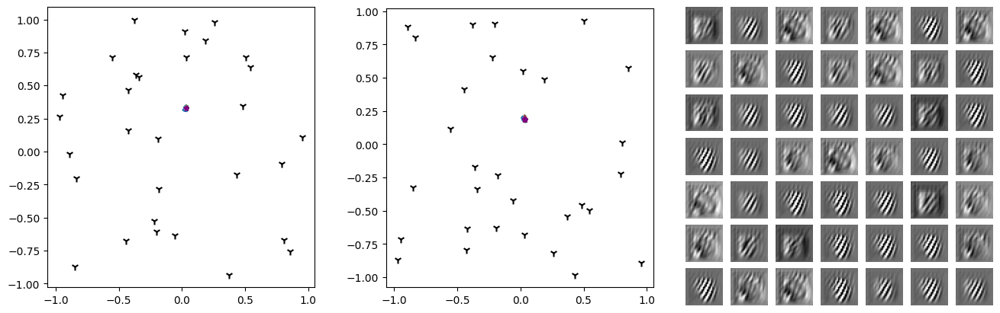

Epoch 294/300 AUC 0.619890096836961


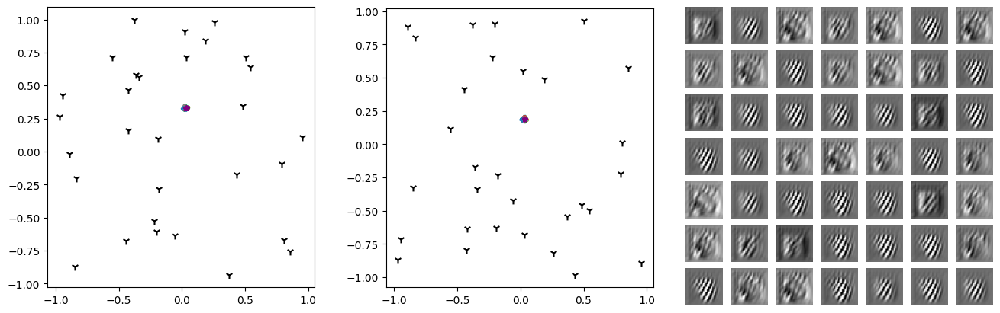

Epoch 297/300 AUC 0.5611856305715192


In [64]:
netG.train()
netD.train()

#ssim_train = piqa.SSIM(window_size=5, n_channels=1, reduction='none').to(device)

writer.add_custom_scalars({'Losses': {'General': ['AUC', 'REGEN', 'FZNORM', 'G', ['POS', 'NEG'], 'EV']}})

for epoch in range(niter):
    report_aver_pos = 0
    report_aver_neg = 0
    report_loss_G = 0
    report_loss_regen = 0
    report_loss_fznorm = 0
    
    report_ev = 0
    local_count = 0
    
    for i, data in enumerate(tqdm(train_loader, desc='Training', disable=True)):
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        netD.zero_grad()
        netG.zero_grad()
        
        noise = torch.rand(batch_size, fuzzy_cores)
        noise = noise / (0.99*noise.sum(-1).reshape(-1,1))
        noise += 0.01*torch.rand(batch_size, 1)
        inp_g = noise.to(device=device)
        fake = netG(inp_g)
        
        firing_r, _, fz_infer, _ = netD(real_cpu)
        limit_real = (1.00 + 0.02 * (1 - 2*torch.rand(batch_size))).to(device)
        errD_real = torch.square(limit_real - firing_r).mean() 
        errD_real.backward(retain_graph=True)

        #fz_norm = (1 - fz_infer.sum(-1)).square().mean() #=+ (1- fz_infer.max(-1).values).square().mean()
        #fz_norm.backward(retain_graph=True)
        
        _, nfiring_r, _, _ = netD(fake.detach())
        limit_fake = (-1.00 + 0.02 * (1 - 2*torch.rand(batch_size))).to(device)
        errD_fake = (limit_fake - nfiring_r).square().mean()
        errD_fake.backward()
        
        ev_loss = keep_eigenvals_positive_loss(netD.fuzzy_white[0]) + keep_eigenvals_positive_loss(netD.fuzzy_black[0]) + keep_eigenvals_positive_loss(netD.fuzzy_gen)
        report_ev = np.maximum(report_ev, ev_loss.item())
        if ev_loss.item() > 0:
            ev_loss.backward()
        
        optimizerD.step()
        
        fz_w, fz_b, _, _ = netD(fake)
        errG = (fz_w + fz_b).square().mean()
        errG.backward()
        
        optimizerG.step()
        
        # _, _, fz_d_real, _ = netD(real_cpu)
        # regen = netG(fz_d_real)
        
        # regen_loss = (real_cpu - regen).square().sum(-1).sum(-1).mean()#(1-ssim_train((real_cpu + 1)/2, (regen + 1)/2)).abs().mean() #
        # regen_loss.backward()
        # optimizerG.step()
        # optimizerD.step()    
        # report_loss_regen += regen_loss.item()

        local_count += 1
        report_loss_G += errG.item()
        report_aver_pos += firing_r.mean().item()
        report_aver_neg += nfiring_r.mean().item()
        #report_loss_fznorm += fz_norm.item()
        
    with torch.no_grad():
        
        if epoch % 3 == 0:
            firings, auc, threshold = get_test_arate_distr(netD, netG)
            writer.add_scalar('AUC', auc, epoch)
            draw_embeddings(netD, netG, epoch)
            print(f"Epoch {epoch}/{niter} AUC {auc}")

        writer.add_scalar('MISC/G', report_loss_G / local_count, epoch)
        writer.add_scalar('POSNEG/POS', report_aver_pos / local_count, epoch)
        writer.add_scalar('POSNEG/NEG', report_aver_neg / local_count, epoch)
        writer.add_scalar('MISC/EV', report_ev, epoch)
        writer.add_scalar('MISC/REGEN', report_loss_regen / local_count, epoch)
        writer.add_scalar('MISC/FZNORM', report_loss_fznorm / local_count, epoch)
        
        
    schedulerD.step()
    schedulerG.step()
    

In [65]:
torch.save(netD.state_dict(), f'weights/netD_{mnist_dissident}.pth')
torch.save(netG.state_dict(), f'weights/netG_{mnist_dissident}.pth')

## Валидация

In [66]:
D = Discriminator(ndf, fuzzy_cores, latent_dim).to(device)
G = Generator(ngf, fuzzy_cores).to(device)
D.load_state_dict(torch.load(f'weights/netD_{mnist_dissident}.pth'))
G.load_state_dict(torch.load(f'weights/netG_{mnist_dissident}.pth'))

#D.eval()
#G.eval()

<All keys matched successfully>

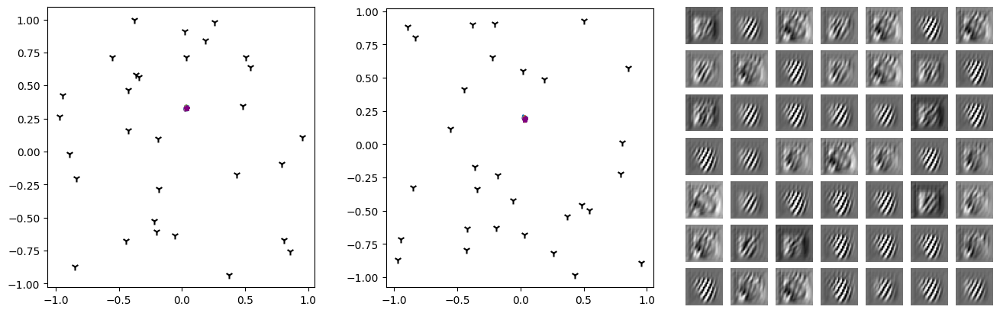

In [67]:
draw_embeddings(D, G, niter)

In [68]:
firings, auc, threshold = get_test_arate_distr(D,G)
print(F"Average firing {firings.mean()}")
print(F"AUC {auc} Threshold {threshold}")


Average firing 0.9861288070678711
AUC 0.636249604054482 Threshold [2.1136217  1.1136217  1.0767877  ... 0.89812744 0.897917   0.8570973 ]


In [69]:
# with torch.no_grad():
#     R, C = 10, 10
#     x = np.linspace(0.0, 1.0, R*C)
#     y = 0.3*x+0.7

#     noise = torch.FloatTensor(np.dstack((x,y))).reshape((-1,nz)).to(device)
#     fake_images, _ = G(noise)
#     fake_images_np = fake_images.cpu().detach().numpy()
#     fake_images_np = fake_images_np.reshape(fake_images_np.shape[0], 28, 28)
    
#     embedings = D.main(fake_images).cpu().numpy()
        
    
#     for i in range(R*C):
#         plt.subplot(R, C, i + 1)
#         plt.imshow(fake_images_np[i], cmap='gray')
#     plt.show()
#     plt.scatter(embedings[:,0],embedings[:,1], s=2)

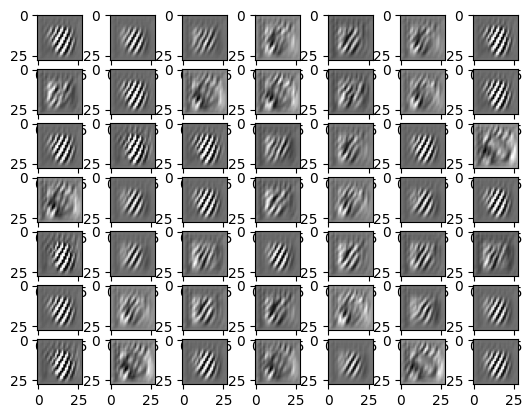

In [70]:
with torch.no_grad():
    
    noise = torch.rand(49, latent_dim, device=device)
    inp_g = netD.fuzzy_gen(noise).detach()
    fake_images = netG(inp_g)

    fake_images_np = fake_images.cpu().detach().numpy()
    fake_images_np = fake_images_np.reshape(fake_images_np.shape[0], 28, 28)
    R, C = 7, 7
    for i in range(49):
        plt.subplot(R, C, i + 1)
        plt.imshow(fake_images_np[i], cmap='gray')
    plt.show()

In [71]:
def get_arate(inp):
    _, _, fz_d, _ = D(inp)
    generated_image = G.main(fz_d.reshape((-1, fuzzy_cores)))
    _, _, fz_d, _ = D(generated_image)
    generated_image = G.main(fz_d.reshape((-1, fuzzy_cores)))
    # _, fz_d, _ = D(generated_image)
    # generated_image = G.main(fz_d.reshape((-1, fuzzy_cores)))
    
    
    diff = ssim((inp+1)/2, (generated_image+1)/2)#1 - torch.cosine_similarity(data.flatten(start_dim=1), generated_image.flatten(start_dim=1))
    rates = (1-diff).abs().detach().cpu().numpy()
    #rates = torch.where(diff > 0.5, 1.0, 0.0).mean(-1).mean(-1).squeeze()
    #diff = (inp-generated_image).squeeze().sum(-1).sum(-1)
    #rates = diff.detach().cpu().numpy()
    
    
    return rates#(1-fz_d.sum(-1)).abs().detach().cpu().numpy() #torch.square(fz_d - fz_g).sum(-1).detach().cpu().numpy()#fz_d.max(-1).values.detach().cpu().numpy() ##torch.cosine_similarity(fz_d, fz_g, dim=-1).detach().cpu().numpy()#(rd+rg-rd*rg).detach().cpu().numpy()#torch.square(embd1 - embd2).sum(-1).detach().cpu().numpy()# # # #

inp = torch.rand((10,1,28,28))
get_arate(inp.to(device))

array([0.9753916 , 1.0075223 , 0.9622543 , 1.0292203 , 0.9697838 ,
       0.9523726 , 0.95841956, 0.9844061 , 1.0634279 , 0.9690063 ],
      dtype=float32)

In [72]:
centroids_r = D.fuzzy_gen.get_centroids().detach().cpu().numpy()
centroids_r

array([[ 2.17531882e-02,  9.11422014e-01,  5.52391171e-01,
         8.80836487e-01,  7.60032594e-01,  9.62815702e-01,
         6.59935296e-01],
       [ 8.05434048e-01, -6.68881893e-01,  1.51777305e-02,
        -9.92174268e-01,  9.41007495e-01,  4.44711864e-01,
         1.10054668e-02],
       [-3.63357127e-01,  5.81945479e-01, -1.68475047e-01,
         8.90233934e-01, -4.87598926e-01, -5.14364064e-01,
         3.79730046e-01],
       [ 3.24283466e-02,  7.15463221e-01, -6.76729977e-01,
        -2.03129053e-01,  3.99282008e-01,  1.77100059e-02,
        -8.71618390e-01],
       [-5.52118003e-01,  7.15428054e-01,  1.19192511e-01,
        -4.14100438e-01, -5.87148964e-01,  3.77642870e-01,
         6.14989102e-01],
       [-1.82068601e-01, -2.82600552e-01, -2.29877919e-01,
         1.45976871e-01,  8.06935847e-01, -9.36793923e-01,
         7.69277215e-01],
       [-4.25855845e-01,  1.58570349e-01, -7.91567385e-01,
         7.88721919e-01,  3.63393784e-01,  9.94747102e-01,
        -4.2133095

Encoding:   0%|          | 0/40 [00:00<?, ?it/s]

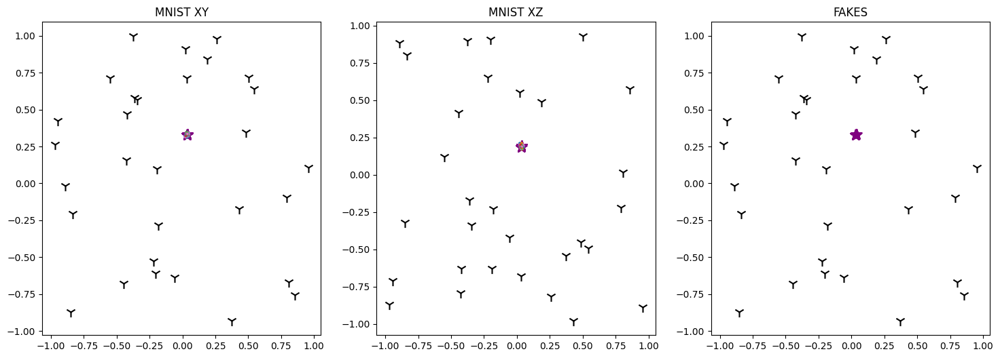

In [73]:
embedings_fake = []

with torch.no_grad():
    batch_size = 256
    
    inp_g = netD.fuzzy_gen(fixed_noise_for_report).detach()
    fake_images = G(inp_g)
    
    embeding = D.main(fake_images)
    embedings_fake.append(embeding.cpu().numpy())

embedings_fake = np.concatenate(embedings_fake, axis=0)    

embedings = []
labels_expected = []
with torch.no_grad():
    for data, target in tqdm(test_loader, desc='Encoding'):
        data = data.view((-1,1,28,28)).to(device)
        embeding = D.main(data)
        embedings.append(embeding.cpu().numpy())
        labels_expected.append(target.cpu().numpy())
embedings = np.concatenate(embedings, axis=0)
labels_expected = np.concatenate(labels_expected, axis=0)

plt.figure(figsize=(18, 6))

R, C = 1, 3

plt.subplot(R, C, 1)
plt.title("MNIST XY")
plt.scatter(embedings_fake[:, 0], embedings_fake[:, 1], c='purple', marker='*', s=120)
plt.scatter(embedings[:, 0],      embedings[:,  1], c=labels_expected, cmap='tab10', s=2)
plt.scatter(centroids_r[:, 0],    centroids_r[:,1], marker='1', c='black', s= 120)
xmin, xmax = plt.xlim()
ymin, ymax = plt.ylim()
plt.subplot(R, C, 2)
plt.title("MNIST XZ")
plt.scatter(embedings_fake[:, 0], embedings_fake[:, 2], c='purple', marker='*', s=120)
plt.scatter(embedings[:, 0],      embedings[:,  2], c=labels_expected, cmap='tab10', s=2)
plt.scatter(centroids_r[:, 0],    centroids_r[:,2], marker='1', c='black', s= 120)

plt.subplot(R, C, 3)
plt.title("FAKES")
plt.scatter(embedings_fake[:, 0], embedings_fake[:, 1], c='purple', marker='*', s=120)
plt.scatter(centroids_r[:, 0], centroids_r[:, 1], marker='1', c='black', s= 120)
plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)
plt.show()

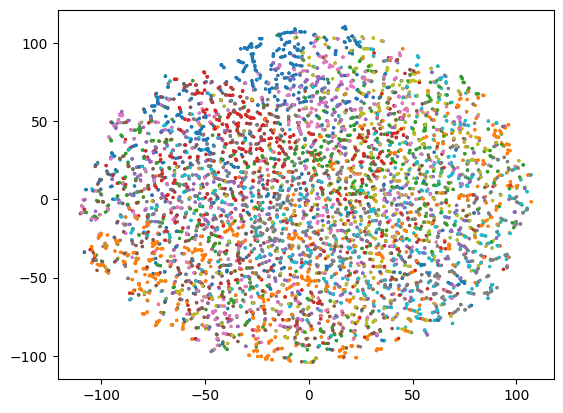

In [74]:
X_embedded = TSNE(n_components=2, learning_rate='auto',
                  init='random', perplexity=3).fit_transform(embedings)
plt.scatter(X_embedded[:, 0],      X_embedded[:,  1], c=labels_expected, cmap='tab10', s=2)

In [75]:
fixed_noise = torch.rand(2, latent_dim)
if torch.cuda.is_available():
    fixed_noise = fixed_noise.cuda()
inp_g = D.fuzzy_gen(fixed_noise).detach()
#inp_g = inp_g.reshape(fuzzy_cores)
fake_images = G(inp_g)


_, fzd,_ = D(fake_images)
fake_images_np = fake_images.cpu().detach().numpy()
fake_images_np = fake_images_np.reshape(fake_images_np.shape[0], 28, 28)
plt.imshow(fake_images_np[0], cmap='gray')
plt.show()
plt.plot(fzd[0].detach().cpu().numpy(), c="red")

ValueError: too many values to unpack (expected 3)

In [ ]:
firings_mnist = {}
firings_mnist['MNIST'] = []
firings_mnist['DISSIDENT'] = []

with torch.no_grad():
    for data, target in tqdm(test_loader, desc='MNIST HIST'):
        data = data.view((-1,1,28,28)).to(device)
        rates = get_arate(data)
        for f, l in  zip(rates, target):
            if l != mnist_dissident:
                firings_mnist['MNIST'].append(f)
            else:
                firings_mnist['DISSIDENT'].append(f)
        

labels, data = firings_mnist.keys(), firings_mnist.values()

fig = plt.figure(figsize =(12, 2))
plt.boxplot(data, notch=True, showfliers=False)
plt.xticks(range(1, len(labels) + 1), labels)
plt.show()

writer.add_figure('Anomaly Detection', fig)

In [ ]:
with torch.no_grad():
    firing_levels = []
    lab_true = []
    lab_pred = []

    for data, lab in tqdm(test_loader, desc='Test MNIST', disable=True):
        data = data.view((-1, 1, 28, 28)).to(device)
        rates = get_arate(data)
        
        for f, l in  zip(rates, lab):
            firing_levels.append(f)
            lab_pred.append(f)        
            if l == mnist_dissident:
                lab_true.append(1)
            else:
                lab_true.append(0)
                    
    fpr, tpr, threshold = metrics.roc_curve(lab_true, lab_pred)
    roc_auc = metrics.auc(fpr, tpr)
    
    fig = plt.figure(figsize =(4, 4))
    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
    writer.add_figure('ROC', fig)

In [ ]:
def find_best_binary_auc_threshold(binary_thresholds,
                               fp_rate,
                               recall,
                               proportion_positive_case: float = 0.5,
                               cost_false_positive: float = 0.5,
                               cost_false_negative: float = 0.5,
                               argmin_axis: int = 0):
    isocost_lines = cost_false_positive * (1 - proportion_positive_case) * fp_rate + cost_false_negative * proportion_positive_case * (1 - recall)
    best_indexes = np.argmin(isocost_lines, axis=argmin_axis)
    best_thresholds = binary_thresholds[best_indexes.tolist()]
    return best_thresholds, best_indexes

th_optimal, _ = find_best_binary_auc_threshold(threshold, fpr, tpr, proportion_positive_case=0.1)
print(f"Optimal threshold {th_optimal}")

In [ ]:
with torch.no_grad():
    img = test_loader.dataset[160][0].view((-1, 1, 28, 28)).to(device)
    img  = torch.cat((img,img))

    w, b, fzd, _ = D(img)
    gimg = G.main(fzd.reshape((-1, fuzzy_cores)))

    diff = (img[0][0] - gimg[0][0]).abs()
    anodet = torch.where(diff > 0.6, -1, img[0][0])

    plt.figure(figsize=(18, 6))

    R, C = 1, 3

    plt.subplot(R, C, 1)
    plt.title("REAL")
    plt.imshow(img[0][0].detach().cpu().numpy())
    plt.subplot(R, C, 2)
    plt.title("REGENERATED")
    plt.imshow(gimg[1][0].detach().cpu().numpy())
    plt.subplot(R, C, 3)
    plt.title("WTH ANOMALY")
    plt.imshow(anodet.detach().cpu().numpy())
    arate = get_arate(img)
    print(F"Anomaly : {arate > th_optimal} ({arate}/{th_optimal})")


In [ ]:
plt.plot(fzd[0].detach().cpu().numpy(), c="red")
#plt.plot(fzg[0].detach().cpu().numpy(), c="blue")
fzd.sum(-1)

In [ ]:
n = 0
fig, ax = plt.subplots(10, 10, figsize=(10, 10))
with torch.no_grad():
    for data, labels in tqdm(test_loader, desc='EMNIST VIS'):
        if n >= 100:
            break
        data = data.view((-1, 1, 28, 28)).to(device) 
        
        arate = get_arate(data)
        
        for i in range(data.shape[0]):
            if(arate[i] > th_optimal):
                img = data[i]
                ax[int(n / 10), int(n % 10)].imshow(img.view(28, 28).cpu().detach().numpy(), cmap='gray')
                ax[int(n / 10), int(n % 10)].axis('off')
                n = n + 1
                    
                if n >= 100:
                    break